<a href="https://colab.research.google.com/github/alexmackfi/Time_Series_2024/blob/main/EDAforExam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install sktime==0.31.0
!pip install tbats

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.0/24.0 MB 69.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 136.2/136.2 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 25.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import ttest_1samp, shapiro

from sklearn.metrics import r2_score

from sktime.forecasting.model_selection import ExpandingWindowSplitter
from sktime.forecasting.arima import AutoARIMA, ARIMA
from sktime.forecasting.ets import AutoETS
from sktime.forecasting.tbats import TBATS

from prophet import Prophet

import statsmodels.api as sm
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.stats.diagnostic import acorr_ljungbox, het_breuschpagan
from statsmodels.graphics import tsaplots
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.api import ExponentialSmoothing

from sktime.performance_metrics.forecasting import MeanSquaredError, MeanAbsoluteError, MeanAbsolutePercentageError

import warnings
warnings.filterwarnings("ignore")

/usr/local/lib/python3.10/dist-packages/dask/dataframe/__init__.py:42: FutureWarning: 
Dask dataframe query planning is disabled because dask-expr is not installed.

You can install it with `pip install dask[dataframe]` or `conda install dask`.
This will raise in a future version.

  warnings.warn(msg, FutureWarning)


# Экзаменационное задание по временным рядам: Прогнозирование продаж в магазинах офлаин-ритейлера в США <a class="tocSkip">

В качестве экзаменационного задания вам предстоит построить модель прогнозирования спроса(продаж) на товары в магазинах офлаин-ритейлера в США . Всего в датасете 3 магазина, в каждом магазине по 15 артикулов (товаров). Вам нужно выбрать 1 магазин (любой из 3).

Прогнозировать продажи нужно на неделю, на месяц и на квартал.

В качестве дополнительной информации вам переданы данные о цене товара (меняются раз в неделю, а также о праздниках в США).

Задание 1. Реализовать класс, который умеет:

1) предобрабатывать исходные данные в удобный формат;

2) обучаться для задачи прогнозирования;

3) оценивать качество своих прогнозов;

4) сохранять модели и подгружать их;

5) Прогнозировать продажи на неделю, на месяц и на квартал.

Должна быть рабочая программа, которая делает инференс (прогнозирование на произвольном тестовом датасете (аналогично тому, который есть у вас)).


Задача 2. Подготовить отчёт о решении данной задачи в виде jupyter ноутбука. В отчёте, в частности, вы должны ответить на следующие вопросы:

1) Какие методы предобработки данных вы использовали?

2) Какие модели пробовали? Почему пробовали именно их?

3) Как вы проверяете качество модели? На каких данных? Какие метрики используюте? Чем обусловлен выбор именно этих метрик?

4) Какое итоговое качество модели на тестовом датасете?

# Пункт 1: Исследовательский анализ данных по магазину

## Визуализация данных по магазину

Буду проводить исследования по `первому магазину`. В первую очередь - посмотрим на данные, которые предложены в задвнии. Вот основная табабличка для предсказания:

In [ ]:
sales = pd.read_csv('data/shop_sales.csv')
sales = sales[sales.store_id=='STORE_1']
sales = sales.drop(columns=['store_id'])
sales.head()

,item_id,date_id,cnt
54570,STORE_1_064,1,0
54571,STORE_1_064,2,1
54572,STORE_1_064,3,0
54573,STORE_1_064,4,0
54574,STORE_1_064,5,0


**Графики** продаж по всем товарам в магазине:

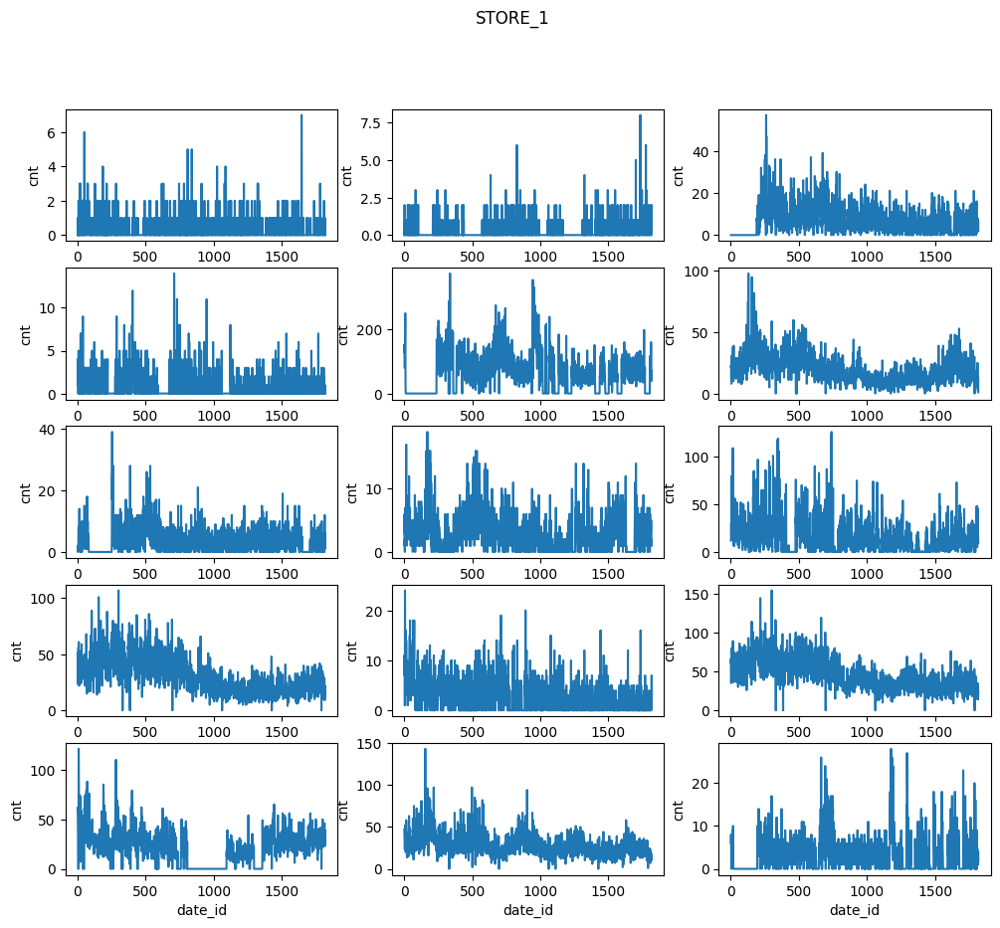

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

for i, art in enumerate(sales.item_id.unique()):
    sns.lineplot(data = sales[(sales.item_id==art)],
                 x='date_id',y='cnt',ax = ax[i//3][i%3])
plt.suptitle("STORE_1");

Есть ещё 2 дополнительные таблицы с информацией, они представленны ниже:

In [ ]:
#данные о датах и праздниках (соединяется с продажами по полю date_id)
calendar = pd.read_csv('data/shop_sales_dates.csv')
calendar.tail()

,date,wm_yr_wk,weekday,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,date_id,CASHBACK_STORE_1,CASHBACK_STORE_2,CASHBACK_STORE_3
1814,2016-01-17,11551,Sunday,2,1,2016,NaN,NaN,NaN,NaN,1815,0,0,0
1815,2016-01-18,11551,Monday,3,1,2016,MartinLutherKingDay,National,NaN,NaN,1816,0,0,0
1816,2016-01-19,11551,Tuesday,4,1,2016,NaN,NaN,NaN,NaN,1817,0,0,0
1817,2016-01-20,11551,Wednesday,5,1,2016,NaN,NaN,NaN,NaN,1818,0,0,0
1818,2016-01-21,11551,Thursday,6,1,2016,NaN,NaN,NaN,NaN,1819,0,0,0


In [ ]:
#данные о датах и ценах (соединяется с датами по полю wm_yr_wk)
prices = pd.read_csv('data/shop_sales_prices.csv')
prices = prices[prices.store_id=='STORE_1']
prices = prices.drop(columns=['store_id'])
prices.tail()

,item_id,wm_yr_wk,sell_price
11136,STORE_1_584,11551,1.00
11137,STORE_1_586,11551,1.68
11138,STORE_1_587,11551,2.48
11139,STORE_1_714,11551,1.58
11140,STORE_1_727,11551,4.48


In [ ]:
prices.isna().any()

,0
item_id,False
wm_yr_wk,False
sell_price,False


## Проверки по данным

Проверим, нет ли пропусков в основных данных и при их наличии - заполним их

In [ ]:
sales.groupby('item_id').size()

,0
item_id,
STORE_1_064,1819
STORE_1_065,1819
STORE_1_090,1819
STORE_1_252,1819
STORE_1_325,1819
STORE_1_339,1819
STORE_1_376,1819
STORE_1_546,1819
STORE_1_547,1819


В основных данных нет пропусков. Здорово!

In [ ]:
prices.groupby('item_id').size()

,0
item_id,
STORE_1_064,260
STORE_1_065,260
STORE_1_090,260
STORE_1_252,260
STORE_1_325,233
STORE_1_339,260
STORE_1_376,260
STORE_1_546,260
STORE_1_547,260


В данных есть пробелы (`STORE_1_325`). Нужно заполнить их.

In [ ]:
pivot_prices = prices.pivot_table(values='sell_price', index='wm_yr_wk', columns='item_id')
pivot_prices.head()

item_id,STORE_1_064,STORE_1_065,STORE_1_090,STORE_1_252,STORE_1_325,STORE_1_339,STORE_1_376,STORE_1_546,STORE_1_547,STORE_1_555,STORE_1_584,STORE_1_586,STORE_1_587,STORE_1_714,STORE_1_727
wm_yr_wk,,,,,,,,,,,,,,,
11101,2.54,2.94,1.25,1.48,NaN,0.88,1.98,5.48,0.2,1.48,1.0,1.48,2.28,1.48,3.98
11102,2.54,2.94,1.25,1.48,NaN,0.88,1.98,5.48,0.2,1.48,1.0,1.48,2.48,1.48,3.98
11103,2.54,2.94,1.25,1.48,NaN,0.88,1.98,5.48,0.2,1.48,1.0,1.48,2.48,1.48,2.98
11104,2.54,2.94,1.25,1.48,NaN,0.88,1.98,5.48,0.2,1.48,1.0,1.48,2.48,1.48,2.98
11105,2.54,2.94,1.25,1.48,NaN,0.88,1.98,5.48,0.2,1.48,1.0,1.48,2.48,1.48,2.98


Убедимся, что пропуски есть только для одного товара

In [ ]:
pivot_prices.isnull().any().sum()

1

Заполним пропуски ближайшим значением цены того же товара из таблицы

In [ ]:
pivot_prices['STORE_1_325'] = pivot_prices['STORE_1_325'].ffill().bfill()

Проверка на то, сработало ли:

In [ ]:
pivot_prices.isnull().any().sum()

0

## Проверки корреляций в данных

### Проверим корреляции по товарам

In [ ]:
pivot_sales = sales.pivot_table(values='cnt', index='date_id', columns='item_id')
pivot_sales.head()

item_id,STORE_1_064,STORE_1_065,STORE_1_090,STORE_1_252,STORE_1_325,STORE_1_339,STORE_1_376,STORE_1_546,STORE_1_547,STORE_1_555,STORE_1_584,STORE_1_586,STORE_1_587,STORE_1_714,STORE_1_727
date_id,,,,,,,,,,,,,,,
1,0.0,0.0,130.0,22.0,0.0,1.0,4.0,3.0,12.0,51.0,10.0,61.0,57.0,47.0,6.0
2,1.0,0.0,153.0,23.0,0.0,2.0,4.0,6.0,15.0,45.0,11.0,67.0,62.0,38.0,8.0
3,0.0,2.0,119.0,12.0,0.0,0.0,1.0,1.0,30.0,25.0,7.0,35.0,49.0,28.0,6.0
4,0.0,0.0,80.0,12.0,0.0,0.0,2.0,2.0,22.0,39.0,11.0,66.0,36.0,27.0,0.0
5,0.0,0.0,80.0,8.0,0.0,0.0,0.0,0.0,13.0,23.0,1.0,37.0,0.0,23.0,2.0


In [ ]:
# viridis, magma, inferno and plasma crest

<Axes: xlabel='item_id', ylabel='item_id'>

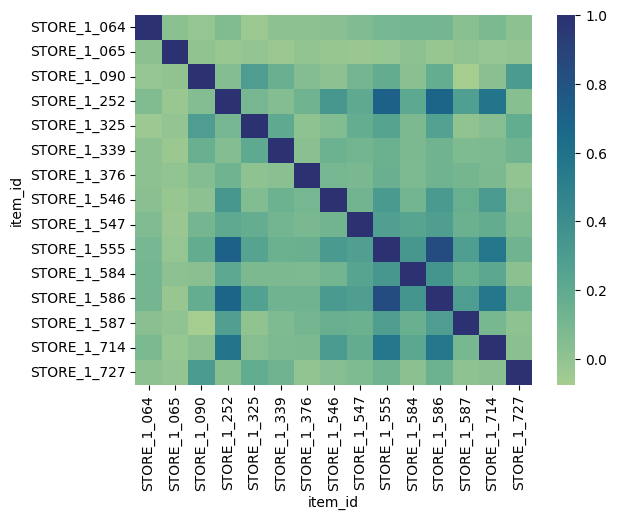

In [ ]:
sns.heatmap(pivot_sales.corr(),cmap='crest')

Сильной корреляции нет, поэтому можно работать не учитывая этот фактор

### Посмотрим корреляцию числа проданных товаров и их цен

Для начала - объединим данные в одну табличку

In [ ]:
day_data = pd.merge(sales,calendar,how='left',on = 'date_id')
day_data = day_data.drop(columns=['weekday','event_name_1', 'event_type_1', 'event_name_2', 'event_type_2', 'CASHBACK_STORE_1', 'CASHBACK_STORE_2','CASHBACK_STORE_3'])
day_data = pd.merge(day_data,prices,how='left',on = ['item_id',	'wm_yr_wk'])
day_data.head()

,item_id,date_id,cnt,date,wm_yr_wk,wday,month,year,sell_price
0,STORE_1_064,1,0,2011-01-29,11101,1,1,2011,2.54
1,STORE_1_064,2,1,2011-01-30,11101,2,1,2011,2.54
2,STORE_1_064,3,0,2011-01-31,11101,3,1,2011,2.54
3,STORE_1_064,4,0,2011-02-01,11101,4,2,2011,2.54
4,STORE_1_064,5,0,2011-02-02,11101,5,2,2011,2.54


Заполним пропуски и в ней

In [ ]:
for id in day_data['item_id'].value_counts().index:
    day_data[day_data['item_id']==id] = day_data[day_data['item_id']==id].ffill().bfill()
day_data.isnull().any().sum()

0

И посмотрим корреляции цен с числом продаж

In [ ]:
for id in day_data['item_id'].value_counts().index:
    print(str(id)+':',round(day_data[day_data['item_id']==id]['cnt'].corr(day_data[day_data['item_id']==id]['sell_price']),3))

STORE_1_064: -0.069
STORE_1_065: 0.034
STORE_1_325: 0.009
STORE_1_376: -0.054
STORE_1_090: -0.196
STORE_1_252: -0.28
STORE_1_339: 0.104
STORE_1_546: -0.18
STORE_1_547: -0.0
STORE_1_555: -0.53
STORE_1_584: nan
STORE_1_586: -0.535
STORE_1_587: -0.33
STORE_1_714: -0.325
STORE_1_727: -0.06


Причина нановской корреляции в нулевой дисперсии цены для этого товара

In [ ]:
day_data[day_data['item_id']=='STORE_1_584'][['cnt','sell_price']].var()

,0
cnt,9.828383
sell_price,0.000000


В целом, больших корреляций нет, за исключением пары товаров, посмотрим среднюю цену и среднее число продаж по ним, чтобы понять, значимы ли эти корреляции

In [ ]:
day_data[day_data['item_id']=='STORE_1_555']['sell_price'].mean()

1.5887960417811982

In [ ]:
day_data[day_data['item_id']=='STORE_1_555']['cnt'].mean()

30.555250137438154

In [ ]:
day_data[day_data['item_id']=='STORE_1_586']['sell_price'].mean()

1.5887960417811982

In [ ]:
day_data[day_data['item_id']=='STORE_1_586']['cnt'].mean()

45.783947223749315

Товары имеют приличную стоимость и продаются в довольшо большом объёме. Стоит обратить на них внимние

Среди товаров есть такие, продаваемость которых зависит от колебаний цен, но их немного. Возможно при выборе моделей, стоит обратить на них внимание

## Проверки стационарности данных

Проведём проверки по двум критериями: Дики-Фуллера и КПСС

При одновременном применении критериев KPSS и ADF могут получиться следующие результаты:
    
* **Вариант 1**: Оба теста говорят, что ряд нестационарный – значит, ряд действительно нестационарный

* **Вариант 2**: Оба теста говорят, что ряд стационарный – ряд стационарный

* **Вариант 3**: KPSS говорит, что ряд стационарный, а ADF говорит, что ряд нестационарный – значит, у вр существует детерминированный тренд, который необходимо убрать, чтобы получить стационарный вр

* **Вариант 4**: KPSS говорит, что ряд нестационарный, а ADF - что ряд стационарный – значит, у вр существует стохастический тренд, который необходимо убрать, чтобы получить стационарный вр

In [ ]:
stationary_results = day_data.groupby("item_id").apply(lambda x: pd.DataFrame([[round(adfuller(x["cnt"])[1],3),
                                                                      round(kpss(x["cnt"])[1],3),
                                                                      (adfuller(x["cnt"])[1]<0.05)&(kpss(x["cnt"])[1]>0.05)
                                                                      ]],
                                                                      columns=["ADF",
                                                                               "KPSS",
                                                                               'Stationarity']))

In [ ]:
stationary_results

,,ADF,KPSS,Stationarity
item_id,,,,
STORE_1_064,0,0.000,0.010,False
STORE_1_065,0,0.000,0.010,False
STORE_1_090,0,0.000,0.041,False
STORE_1_252,0,0.120,0.010,False
STORE_1_325,0,0.018,0.010,False
STORE_1_339,0,0.000,0.032,False
STORE_1_376,0,0.000,0.010,False
STORE_1_546,0,0.000,0.010,False
STORE_1_547,0,0.000,0.010,False


Итого, у нас есть всего один стационарный по обоим критериям ряд (`STORE_1_727`), три ряда не стационарных по обоим критериям (`STORE_1_252, STORE_1_555, STORE_1_586`), все остальные
стационарны по Дики-Фуллеру и нестационарны по KPSS

Из этого можно сделать вывод, что модели, предназначенные для стационарных рядов сюда не подойдут. Разве что можно попробовать применить их к стационарному ряду (`STORE_1_727`) или попробовать дифференцирование для рядов (`STORE_1_252, STORE_1_555, STORE_1_586`)

## Разложения рядов на тренд сезонность и остатки

In [ ]:
params = {'lines.linewidth': 4,
          'lines.solid_capstyle': 'butt',
          'axes.labelsize': 'large',
          'axes.axisbelow': True,
          'axes.grid': True,
          'axes.linewidth': 3.0,
          'axes.titlesize': 'x-large',
          'grid.linestyle': '-',
          'grid.linewidth': 1.0,
          'xtick.major.size': 0,
          'xtick.minor.size': 0,
          'ytick.major.size': 0,
          'ytick.minor.size': 0,
          'figure.subplot.left': 0.08,
          'figure.subplot.right': 0.95,
          'figure.subplot.bottom': 0.07,
          'figure.figsize': (12.8, 7.8),
          'figure.autolayout': True,
          'figure.dpi': 300,
          'font.size': 18.0 }
plt.rcParams.update(params)

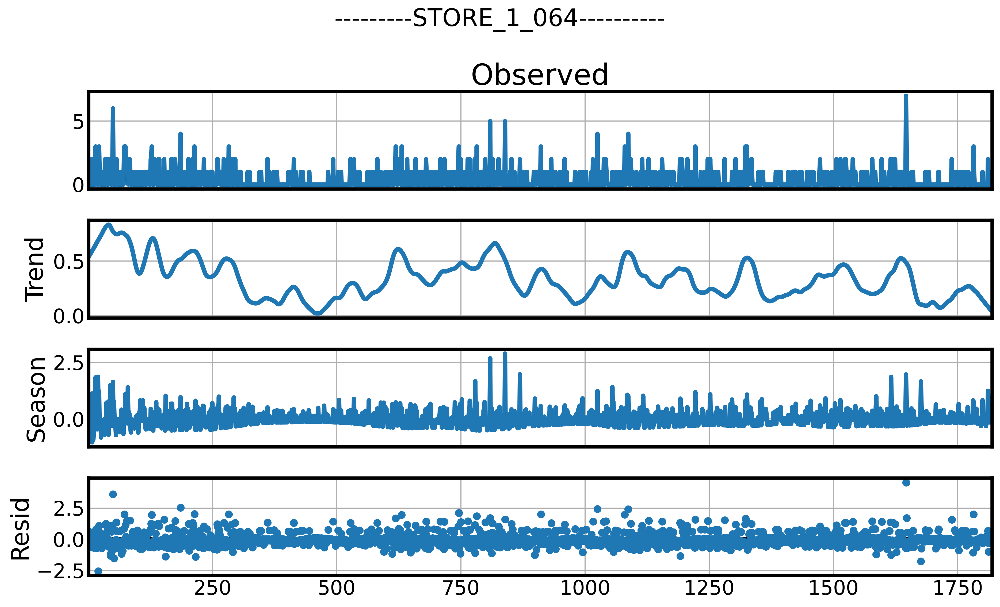

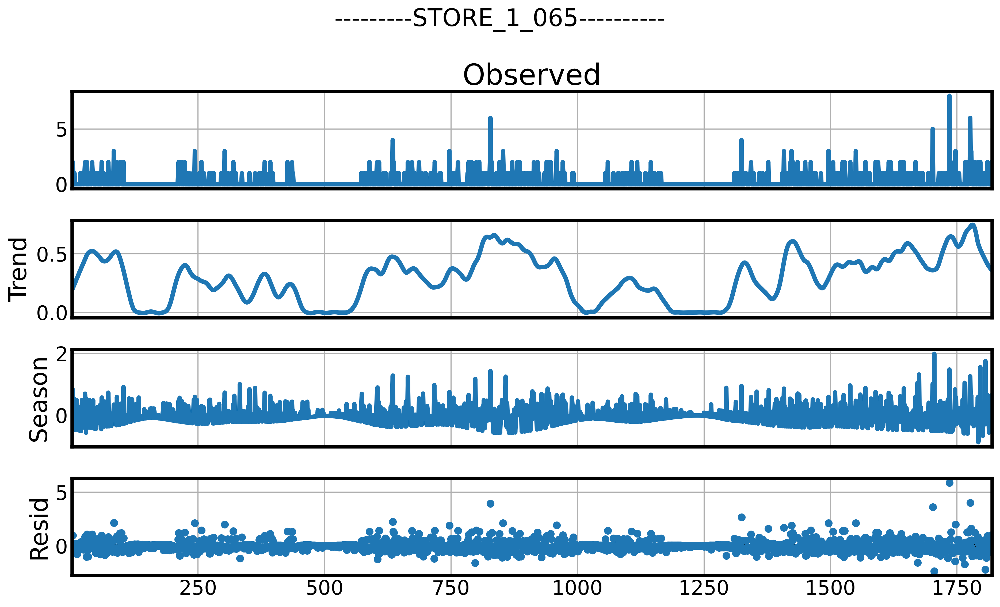

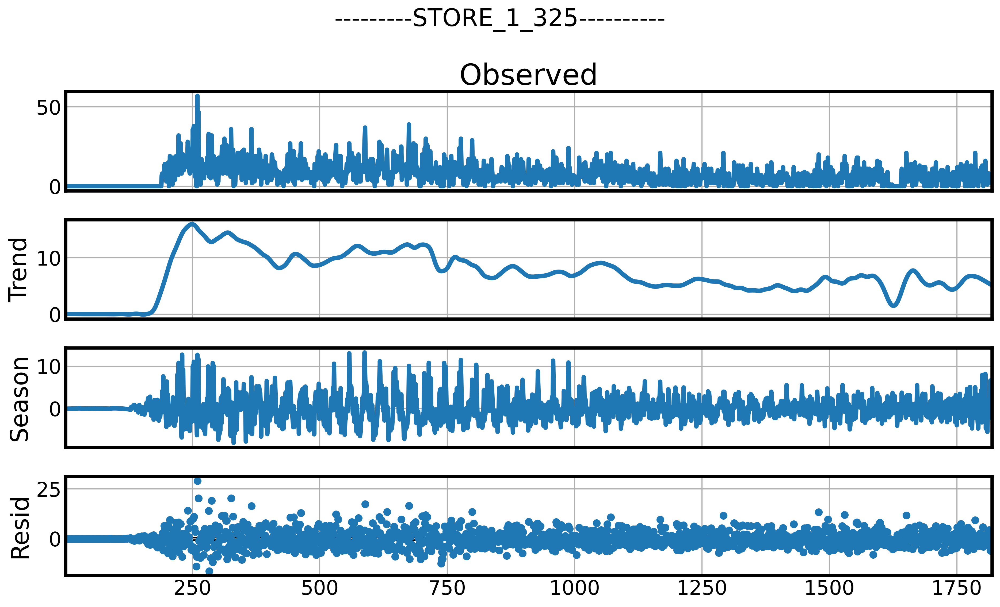

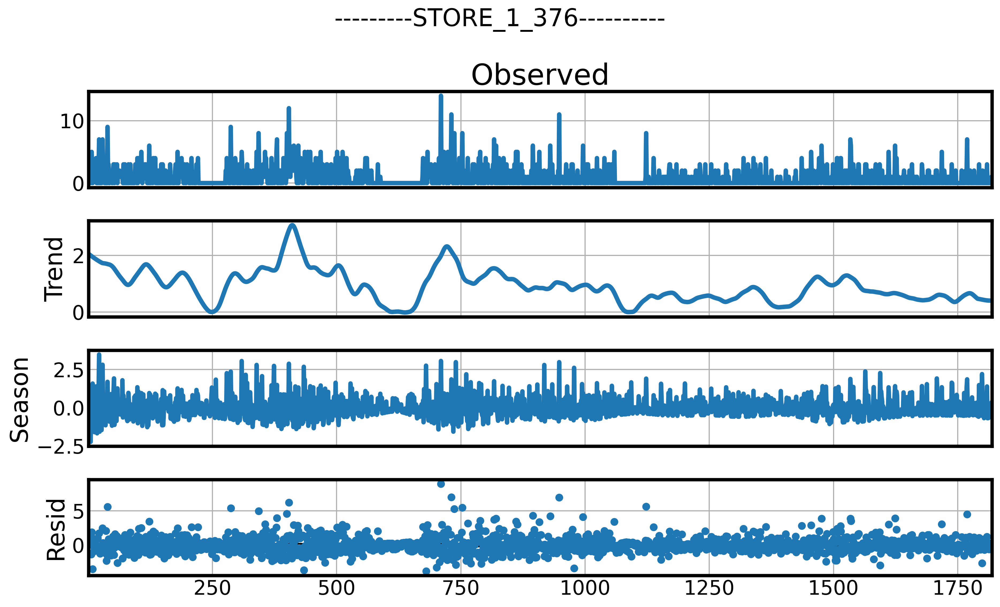

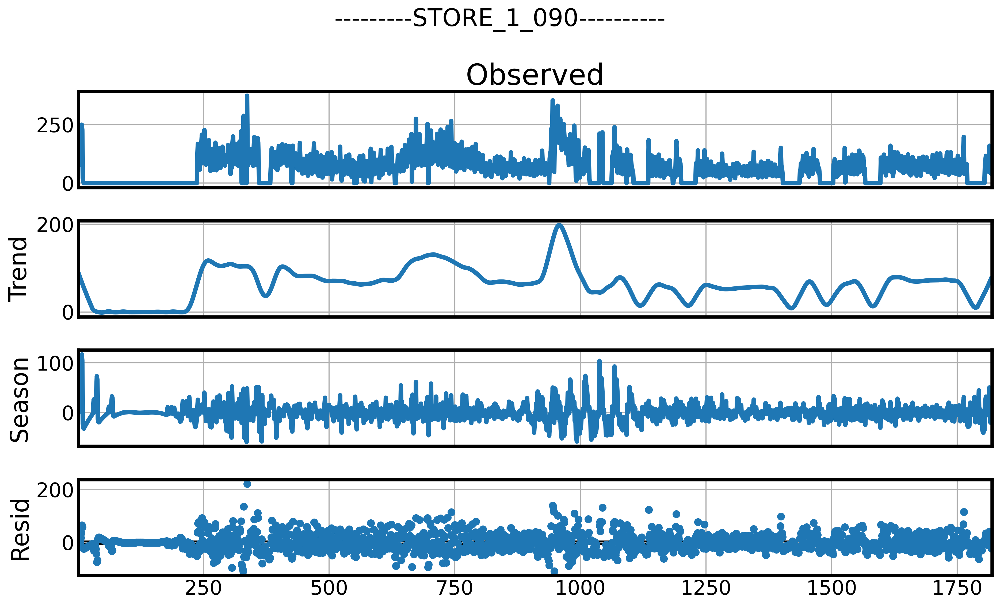

...

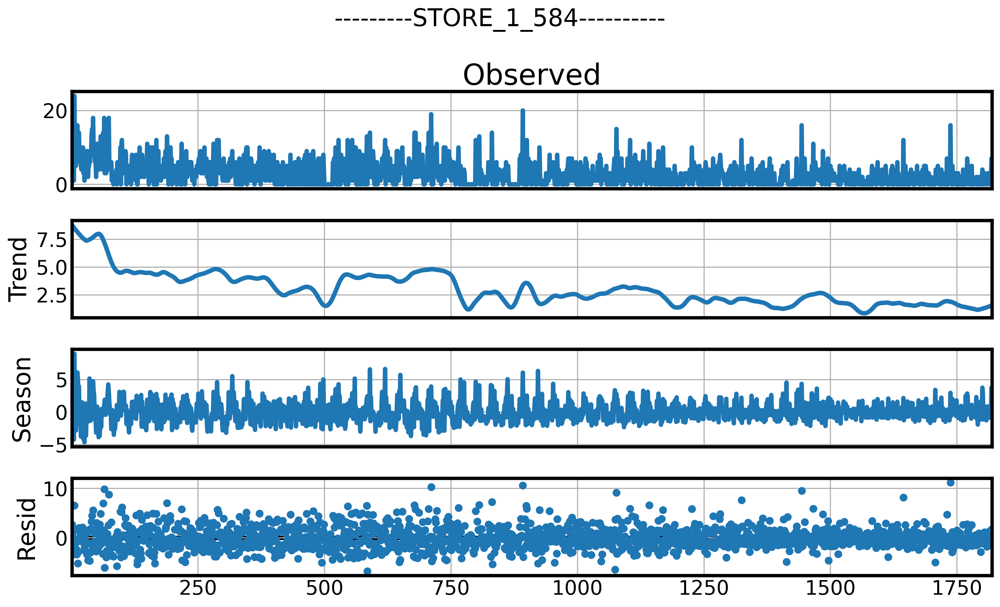

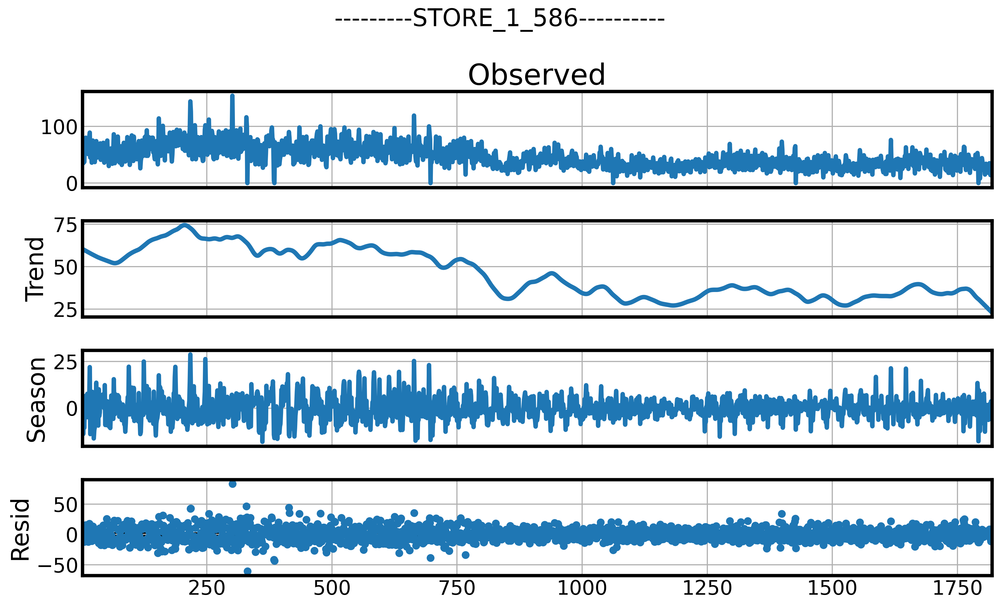

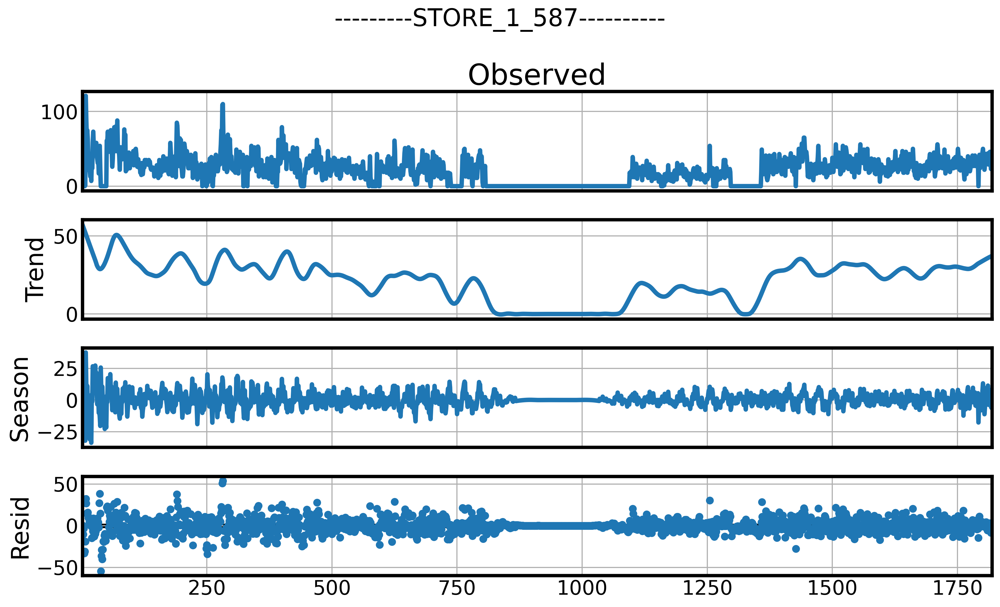

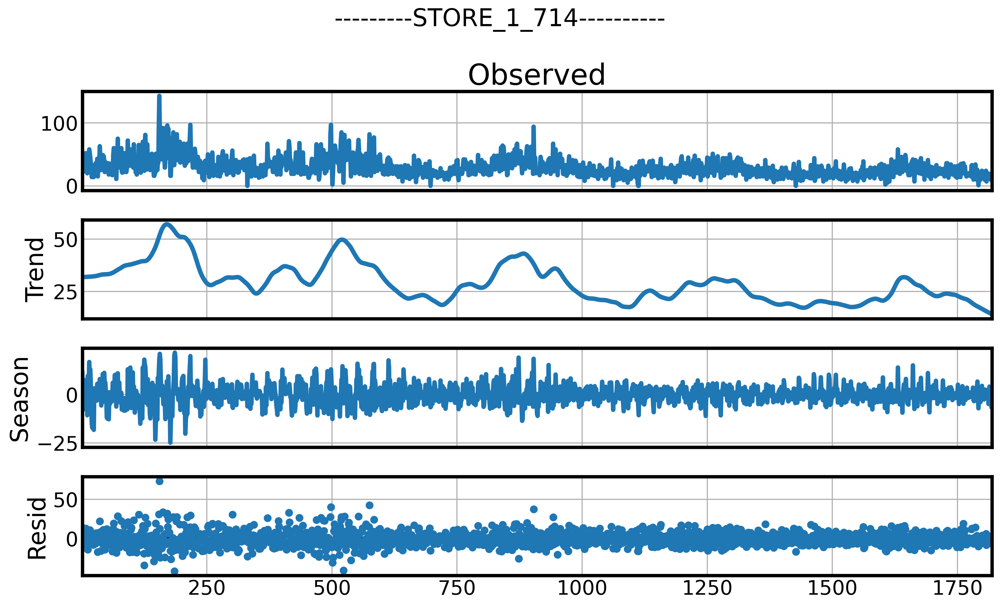

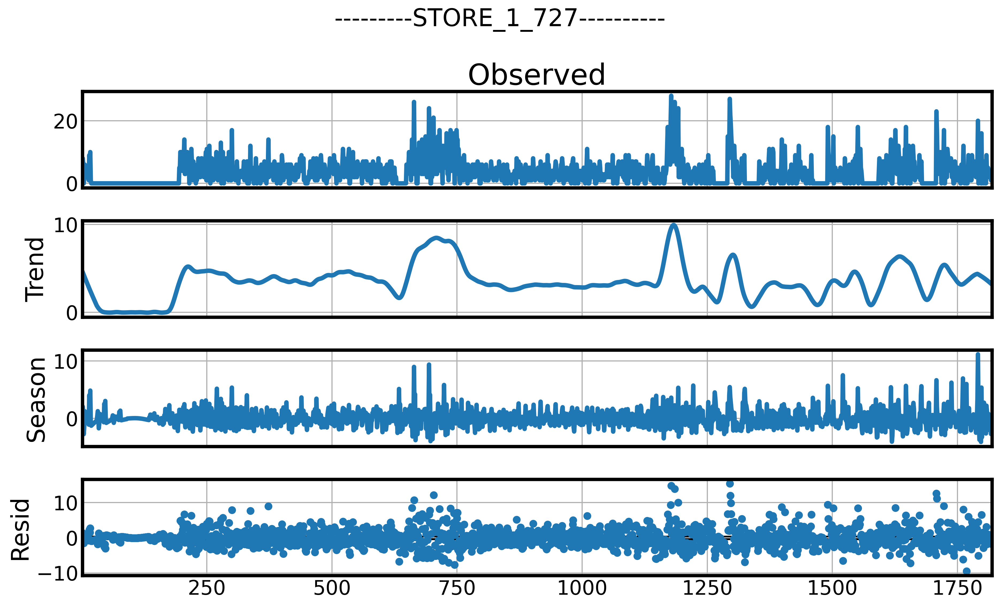

In [ ]:
for i, art in enumerate(sales.item_id.unique()):

    df_art = sales[sales.item_id==art]
    df_art = df_art.set_index('date_id')[['cnt']]
    mod_decomp = STL(df_art,period=30).fit()
    mod_decomp.plot()
    plt.suptitle("---------"+str(art)+"----------")


Если посмотреть на тренды по графикам, то, как и ожиладось, выделяются три товарища, стационарные по Дики-Фуллеру и нестационарные по KPSS (`STORE_1_252, STORE_1_555, STORE_1_586`), также слабый тренд наблюдается у товаров (`STORE_1_714, STORE_1_584`). По остальным, как будто сильно-выраженного тренда не наблюдается

Если посмотреть на сезонность, то какой-то мультипликативности в ней нет. Есть всплески (или наоборот проседания), могу предположить, что это связано с праздниками. Можно попробовать поучить модельки, использующие данные о праздниках

Можно попробовать оценить остатки:

In [ ]:
# Функция из семинаров
def check_fit(resids):

    """
    Проверка остатков на равенство нулю среднего, на стационарность, нормальность, отсутствие автокорреляций и
    гомоскедастичность.
    """

    #mean = 0
    mean_t, mean_pval = ttest_1samp(resids,0)

    # stationary
    stat_t, stat_pval = adfuller(resids,maxlag=6)[:2]

    # normality
    norm_t, norm_pval = shapiro(resids)

    # autocorr
    autocor_pval = (acorr_ljungbox(resids,model_df=0,return_df=False)['lb_pvalue'] <0.05).sum()==0

    # heteroscedasticity
    lm, lm_pval, ff, ff_pval = \
    het_breuschpagan(resids,sm.add_constant(resids.reset_index().index))

    records = {
        "mean_resids" : np.mean(resids),
        "mean_t" : mean_t,
        "mean_pval" : mean_pval,
        "stationary_t" : stat_t,
        "stationary_pval": 1 - stat_pval, # поменяли знак, чтобы желаемый результат всех проверок p_value>0.05
        'autocor_pval': autocor_pval,
        "norm_t" : norm_t,
        "norm_pval" : norm_pval,
        "heteroscedasticity_t" : ff,
        "heteroscedasticity_pval" : ff_pval,
        "check_result" : (mean_pval>0.05) & (stat_pval<0.05) & (norm_pval>0.05) &\
        (ff_pval>0.05) & autocor_pval
       }

    return records

In [ ]:
resid_check = []
for i, art in enumerate(sales.item_id.unique()):

    df_art = sales[sales.item_id==art]
    df_art = df_art.set_index('date_id')[['cnt']]
    mod_decomp = STL(df_art,period=30).fit()
    resid_check.append(check_fit(mod_decomp.resid))
    print(check_fit(mod_decomp.resid))

{'mean_resids': 0.0004425381917649663, 'mean_t': 0.03639620957728207, 'mean_pval': 0.970970432260768, 'stationary_t': -23.11076603963385, 'stationary_pval': 1.0, 'autocor_pval': False, 'norm_t': 0.8880854307711066, 'norm_pval': 2.1780368649045037e-34, 'heteroscedasticity_t': 5.782620966299515, 'heteroscedasticity_pval': 0.016284875618361113, 'check_result': False}
{'mean_resids': 0.0004971144433157004, 'mean_t': 0.04175053337565603, 'mean_pval': 0.9667021537895534, 'stationary_t': -18.51464829838661, 'stationary_pval': 1.0, 'autocor_pval': False, 'norm_t': 0.8429884586066364, 'norm_pval': 4.0897216794153976e-39, 'heteroscedasticity_t': 14.077159992835432, 'heteroscedasticity_pval': 0.00018096759709996531, 'check_result': False}
{'mean_resids': 0.001822034220109474, 'mean_t': 0.019929295998236497, 'mean_pval': 0.9841019618837491, 'stationary_t': -17.249418201952402, 'stationary_pval': 1.0, 'autocor_pval': False, 'norm_t': 0.95554460142276, 'norm_pval': 4.092184237559937e-23, 'heterosced

Не очень удобно, посмотрим просто на результаты проверки:

In [ ]:
resid_check[1]

{'mean_resids': 0.0004971144433157004,
 'mean_t': 0.04175053337565603,
 'mean_pval': 0.9667021537895534,
 'stationary_t': -18.51464829838661,
 'stationary_pval': 1.0,
 'autocor_pval': False,
 'norm_t': 0.8429884586066364,
 'norm_pval': 4.0897216794153976e-39,
 'heteroscedasticity_t': 14.077159992835432,
 'heteroscedasticity_pval': 0.00018096759709996531,
 'check_result': False}

In [ ]:
for i, art in enumerate(sales.item_id.unique()):
    print(str(art)+':',resid_check[i]['check_result'])

STORE_1_064: False
STORE_1_065: False
STORE_1_325: False
STORE_1_376: False
STORE_1_090: False
STORE_1_252: False
STORE_1_339: False
STORE_1_546: False
STORE_1_547: False
STORE_1_555: False
STORE_1_584: False
STORE_1_586: False
STORE_1_587: False
STORE_1_714: False
STORE_1_727: False


По остаткам видно, что обычного STL будем мало и нужно пробывать что-то более неординарное и сложное. В общем, так и предполагалось

# Пункт 2: Предварительные метрики для оценки

Чтобы потыкать модельки, нужно их как-то оценивать. Пока будем оценивать по всему (используем функцию из семинаров для этого), чему можно, а дальще посмотрим более основательно

In [ ]:
def f_metrics_report(y_pred,
                   y_true
                  ):

    """
    Функция оценки качества прогноза. Оценивает персентили распределения ошибки
    (медиану, среднее, 3й квартиль и 95-персентиль)
    по абсолютной и относительной процентной ошибки для прогноза с помощью модели (y_pred) и
    для базового прогноза, равному среднему значению вр.

    """


    y_true_mean = y_true.mean()*np.ones(shape=(len(y_true),))

    mses = (((y_pred - y_true)**2).sum(axis = 0) / len(y_pred))**0.5
    maes = abs((y_pred - y_true)).sum(axis = 0) / len(y_pred)

    res = pd.DataFrame([mses,
                        maes],
                       index=[
                           'mses',
                           'maes'
                           ])

    res.loc["r2",:] = r2_score(y_true, y_pred)

    return res

In [ ]:
def metrics_report(y_true,
                   y_pred
                  ):

    mape_func = MeanAbsolutePercentageError()
    mae_func = MeanAbsoluteError()
    mse_func = MeanSquaredError()


    mapes = mape_func.evaluate_by_index(y_true,y_pred)*100
    maes = mae_func.evaluate_by_index(y_true,y_pred)
    mses = mse_func.evaluate_by_index(y_true,y_pred)


    stats_list = ['mean','median']

    res = pd.DataFrame([maes.agg(stats_list),
                        mses.agg(stats_list),
                        mapes.agg(stats_list)],
                       index=['maes','mses','mapes'])

    res.loc["r2",:] = r2_score(y_true, y_pred)

    return res

In [ ]:
def mean_metrics_report(y_true,
                   y_pred
                  ):

    mape_func = MeanAbsolutePercentageError()
    mae_func = MeanAbsoluteError()
    mse_func = MeanSquaredError()


    mapes = mape_func.evaluate_by_index(y_true,y_pred)*100
    maes = mae_func.evaluate_by_index(y_true,y_pred)
    mses = mse_func.evaluate_by_index(y_true,y_pred)


    stats_list = ['mean']

    res = pd.DataFrame([maes.agg(stats_list),
                        mses.agg(stats_list)],
                       index=['maes','mses'])

    res.loc["r2",:] = r2_score(y_true, y_pred)

    return res

In [ ]:
def median_metrics_report(y_true,
                   y_pred
                  ):

    mape_func = MeanAbsolutePercentageError()
    mae_func = MeanAbsoluteError()
    mse_func = MeanSquaredError()


    mapes = mape_func.evaluate_by_index(y_true,y_pred)*100
    maes = mae_func.evaluate_by_index(y_true,y_pred)
    mses = mse_func.evaluate_by_index(y_true,y_pred)


    stats_list = ['median']

    res = pd.DataFrame([maes.agg(stats_list),
                        mses.agg(stats_list),],
                       index=['maes','mses'])

    res.loc["r2",:] = r2_score(y_true, y_pred)

    return res

# Пункт 3: Модели и эксперименты с моделями

Разделим на трейн и тест, чтобы можно было оценивать

In [ ]:
day_data["date"] = pd.to_datetime(day_data["date"])
day_data.head()

,item_id,date_id,cnt,date,wm_yr_wk,wday,month,year,sell_price
0,STORE_1_064,1,0,2011-01-29,11101,1,1,2011,2.54
1,STORE_1_064,2,1,2011-01-30,11101,2,1,2011,2.54
2,STORE_1_064,3,0,2011-01-31,11101,3,1,2011,2.54
3,STORE_1_064,4,0,2011-02-01,11101,4,2,2011,2.54
4,STORE_1_064,5,0,2011-02-02,11101,5,2,2011,2.54


In [ ]:
data = []
data_train = []
data_test = []
for i, art in enumerate(sales.item_id.unique()):
    data.append(day_data[day_data['item_id']==art][['date','cnt']].set_index('date'))
    data_train.append(day_data[day_data['item_id']==art][['date','cnt']].set_index('date').iloc[:-90])
    data_test.append(day_data[day_data['item_id']==art][['date','cnt']].set_index('date').iloc[-90:])

In [ ]:
data_test[0]

,cnt
date,
2015-10-24,0
2015-10-25,0
2015-10-26,0
2015-10-27,0
2015-10-28,0
...,...
2016-01-17,0
2016-01-18,0
2016-01-19,0


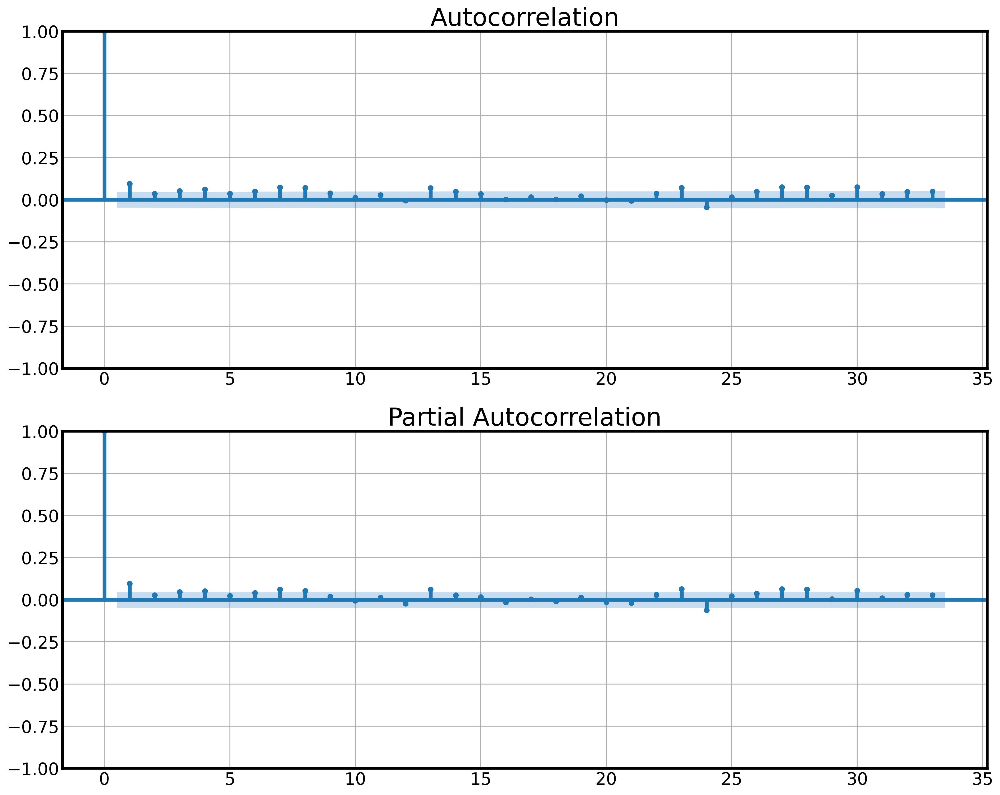

In [ ]:
fig,ax =plt.subplots(2,1,figsize= (15,12))
tsaplots.plot_acf(data_train[0]['cnt'],ax=ax[0]);
tsaplots.plot_pacf(data_train[0]['cnt'],ax=ax[1]);

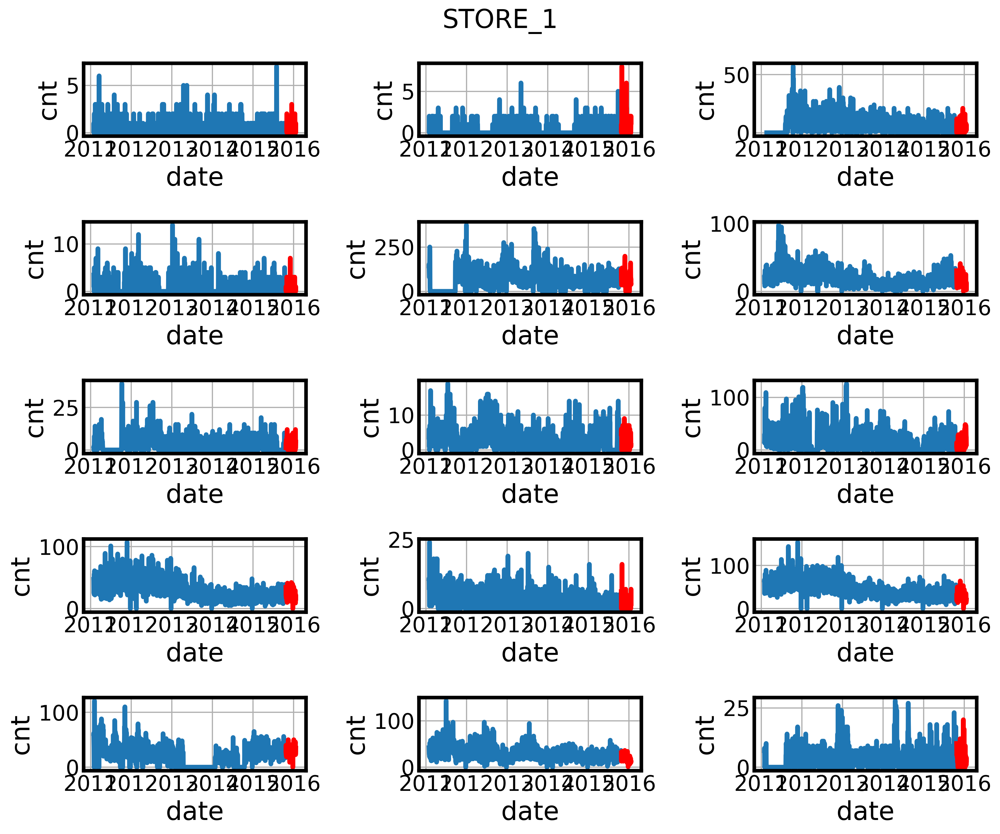

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

for i, art in enumerate(sales.item_id.unique()):
    sns.lineplot(data = data_train[i],
                 x='date',y='cnt',ax = ax[i//3][i%3])
    sns.lineplot(data = data_test[i],
                 x='date',y='cnt',ax = ax[i//3][i%3],color = 'red')
plt.suptitle("STORE_1");

## Наивный прогноз

Как бейзлайн, используем наивный прогноз (сдвиг на шаг назад). Нужно же с чем-то сравнивать

In [ ]:
data_test[i]['cnt'].iloc[-90:].values

array([11,  9,  5,  6,  5,  6,  4,  8,  7,  2,  6,  3,  0,  0,  5,  7,  5,
        1,  2,  1,  1,  5,  3,  2,  4,  1,  0,  0,  6,  4,  5,  4, 12,  2,
        0,  3,  2,  0,  0,  3,  0,  2,  9,  8,  2,  3,  1,  4,  1,  9,  7,
        3,  6,  3,  3,  4,  7,  2,  3,  7,  7, 20,  0,  3,  1,  1,  4,  0,
       16,  0,  3,  6,  0,  7,  4,  0,  3,  0,  9,  3,  2,  5,  4,  2,  4,
        2,  3,  1,  4,  2])

In [ ]:
data_train[1]['cnt'].iloc[-7:]

,cnt
date,
2015-10-17,0
2015-10-18,1
2015-10-19,0
2015-10-20,0
2015-10-21,1
2015-10-22,0
2015-10-23,0


In [ ]:
# res7,res30,res90 = [],[],[]
# for i, art in enumerate(sales.item_id.unique()):
#     res7.append(f_metrics_report(data_train[i]['cnt'].iloc[-7:].values, data_test[i]['cnt'].iloc[:7].values))
#     res30.append(f_metrics_report(data_train[i]['cnt'].iloc[-30:].values, data_test[i]['cnt'].iloc[:30].values))
#     res90.append(f_metrics_report(data_train[i]['cnt'].iloc[-90:].values, data_test[i]['cnt'].iloc[:90].values))

In [ ]:
res7,res30,res90 = [],[],[]
for i, art in enumerate(sales.item_id.unique()):
    res7.append(metrics_report(data_train[i]['cnt'].iloc[-7:].values, data_test[i]['cnt'].iloc[:7].values))
    res30.append(metrics_report(data_train[i]['cnt'].iloc[-30:].values, data_test[i]['cnt'].iloc[:30].values))
    res90.append(metrics_report(data_train[i]['cnt'].iloc[-90:].values, data_test[i]['cnt'].iloc[:90].values))

In [ ]:
mean_res7,mean_res30,mean_res90 = [],[],[]
for i, art in enumerate(sales.item_id.unique()):
    mean_res7.append(mean_metrics_report(data_train[i]['cnt'].iloc[-7:].values, data_test[i]['cnt'].iloc[:7].values))
    mean_res30.append(mean_metrics_report(data_train[i]['cnt'].iloc[-30:].values, data_test[i]['cnt'].iloc[:30].values))
    mean_res90.append(mean_metrics_report(data_train[i]['cnt'].iloc[-90:].values, data_test[i]['cnt'].iloc[:90].values))

median_res7,median_res30,median_res90 = [],[],[]
for i, art in enumerate(sales.item_id.unique()):
    median_res7.append(median_metrics_report(data_train[i]['cnt'].iloc[-7:].values, data_test[i]['cnt'].iloc[:7].values))
    median_res30.append(median_metrics_report(data_train[i]['cnt'].iloc[-30:].values, data_test[i]['cnt'].iloc[:30].values))
    median_res90.append(median_metrics_report(data_train[i]['cnt'].iloc[-90:].values, data_test[i]['cnt'].iloc[:90].values))

Напишем функцию для усреднение ошибок для всех товаров, будем оценивать алгоритм в совокупности

In [ ]:
def final_result(mean_res7,mean_res30,mean_res90,median_res7,median_res30,median_res90):
    mean_result7 = pd.concat(mean_res7, axis=1).reindex(mean_res7[0].index)
    mean_result30 = pd.concat(mean_res30, axis=1).reindex(mean_res30[0].index)
    mean_result90 = pd.concat(mean_res90, axis=1).reindex(mean_res90[0].index)

    median_result7 = pd.concat(median_res7, axis=1).reindex(median_res7[0].index)
    median_result30 = pd.concat(median_res30, axis=1).reindex(median_res30[0].index)
    median_result90 = pd.concat(median_res90, axis=1).reindex(median_res90[0].index)

    result7 = pd.concat([mean_result7.mean(axis=1),median_result7.mean(axis=1)], axis=1).reindex(median_result7.index)
    result30 = pd.concat([mean_result30.mean(axis=1),median_result30.mean(axis=1)], axis=1).reindex(mean_result30.index)
    result90 = pd.concat([mean_result90.mean(axis=1),median_result90.mean(axis=1)], axis=1).reindex(mean_result90.index)

    columns = ['mean_week','median_week','mean_month','median_month','mean_quarter','median_quarter']

    result = pd.concat([result7,result30,result90], axis=1)
    result.columns = columns

    return result

In [ ]:
result = final_result(mean_res7,mean_res30,mean_res90,median_res7,median_res30,median_res90)

Можно потыкать также и для отдельных товаров

In [ ]:
mean_result7 = pd.concat(mean_res7, axis=1).reindex(mean_res7[0].index)
mean_result7.columns = sales.item_id.unique()
mean_result7

,STORE_1_064,STORE_1_065,STORE_1_325,STORE_1_376,STORE_1_090,STORE_1_252,STORE_1_339,STORE_1_546,STORE_1_547,STORE_1_555,STORE_1_584,STORE_1_586,STORE_1_587,STORE_1_714,STORE_1_727
maes,0.0,1.428571,5.000000,0.571429,14.571429,7.000000,1.857143,1.285714,6.857143,8.000000,1.571429,12.285714,5.571429,8.285714,3.428571
mses,0.0,9.428571,37.571429,0.857143,392.000000,58.714286,4.142857,3.571429,83.714286,89.428571,6.142857,194.571429,43.571429,99.714286,21.142857
r2,1.0,-45.200000,-2.473585,-0.615385,0.433392,-0.013028,0.514354,0.375000,-0.918616,-0.715740,-7.852941,-0.809108,0.508065,-1.161947,0.277545


In [ ]:
mean_result7.mean(axis=1)

,0
maes,5.180952
mses,69.638095
r2,-3.776800


In [ ]:
pd.concat(res7, axis=1).reindex(res7[0].index)

,mean,median,mean,median,mean,median,mean,median,mean,median,...,mean,median,mean,median,mean,median,mean,median,mean,median
maes,0.0,0.0,1.428571,0.0,5.000000,4.000000,0.571429,0.000000,14.571429,7.000000,...,1.571429,1.000000,12.285714,15.000000,5.571429,6.000000,8.285714,6.000000,3.428571,2.000000
mses,0.0,0.0,9.428571,0.0,37.571429,16.000000,0.857143,0.000000,392.000000,49.000000,...,6.142857,1.000000,194.571429,225.000000,43.571429,36.000000,99.714286,36.000000,21.142857,4.000000
mapes,NaN,NaN,inf,inf,inf,75.000000,inf,100.000000,18.629040,16.279070,...,inf,350.000000,36.693043,37.500000,18.863853,20.000000,38.244174,31.578947,inf,35.294118
r2,1.0,1.0,-45.200000,-45.2,-2.473585,-2.473585,-0.615385,-0.615385,0.433392,0.433392,...,-7.852941,-7.852941,-0.809108,-0.809108,0.508065,0.508065,-1.161947,-1.161947,0.277545,0.277545


In [ ]:
median_result7 = pd.concat(median_res7, axis=1).reindex(median_res7[0].index)
median_result7.columns = sales.item_id.unique()
median_result7

,STORE_1_064,STORE_1_065,STORE_1_325,STORE_1_376,STORE_1_090,STORE_1_252,STORE_1_339,STORE_1_546,STORE_1_547,STORE_1_555,STORE_1_584,STORE_1_586,STORE_1_587,STORE_1_714,STORE_1_727
maes,0.0,0.0,4.000000,0.000000,7.000000,6.000000,2.000000,1.000,4.000000,8.00000,1.000000,15.000000,6.000000,6.000000,2.000000
mses,0.0,0.0,16.000000,0.000000,49.000000,36.000000,4.000000,1.000,16.000000,64.00000,1.000000,225.000000,36.000000,36.000000,4.000000
r2,1.0,-45.2,-2.473585,-0.615385,0.433392,-0.013028,0.514354,0.375,-0.918616,-0.71574,-7.852941,-0.809108,0.508065,-1.161947,0.277545


In [ ]:
median_result7.mean(axis=1)

,0
maes,4.133333
mses,32.533333
r2,-3.776800


In [ ]:
# result30 = pd.concat(res30, axis=1).reindex(res30[0].index)
# result30.columns = sales.item_id.unique()
# result30

In [ ]:
# result30.mean(axis=1)

In [ ]:
# result90 = pd.concat(res90, axis=1).reindex(res90[0].index)
# result90.columns = sales.item_id.unique()
# result90

In [ ]:
# result90.mean(axis=1)

## ARIMA

Самое простое, что приходит - попробовать модель ARIMA. Не думаю, что она даст хорошие результаты для предсказаний на месяц и на квартал, но попробуем, для недели есть потенциал

Для начала, посмотрим, что для недели даст AutoARIMA на одном рандомном ряду, оценим скорость и возможность её использовать для каждого ряда

In [ ]:
%%time
forecaster = AutoARIMA(sp=7, suppress_warnings=True)
# cv = ExpandingWindowSplitter(step_length=1, fh=[7,31,91], initial_window=91*3)

# df = evaluate(forecaster=forecaster, y=train_data, cv=cv, strategy="refit", return_data=True)

# df.iloc[:, :5].head()
forecaster.fit(data_train[2]['cnt'])
y_pred = forecaster.predict(data_test[2].index)

CPU times: user 15min 1s, sys: 7.96 s, total: 15min 9s
Wall time: 9min 12s


In [ ]:
metrics_report(data_test[2]['cnt'], y_pred)

,mean,median
maes,3.583785,3.293997
mses,20.407131,10.852683
mapes,inf,49.566297
r2,-0.020325,-0.020325


<Axes: xlabel='date', ylabel='cnt'>

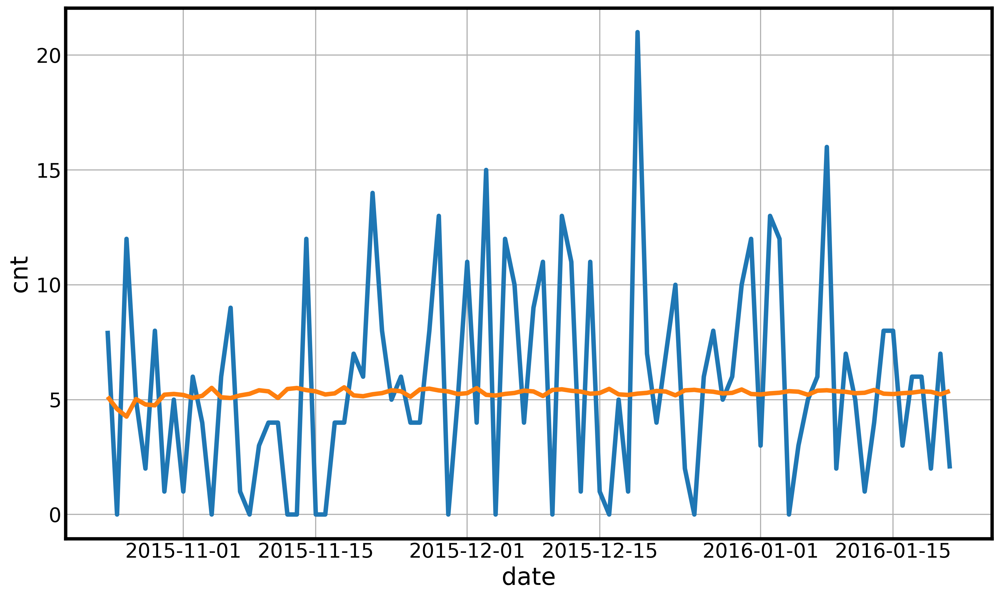

In [ ]:
sns.lineplot(x=data_test[2]['cnt'].index,y=data_test[2]['cnt'].values)
sns.lineplot(x=data_test[2].index,y=y_pred)

Слишком долго и не очень многообещающе, попробуем с сделать ручками

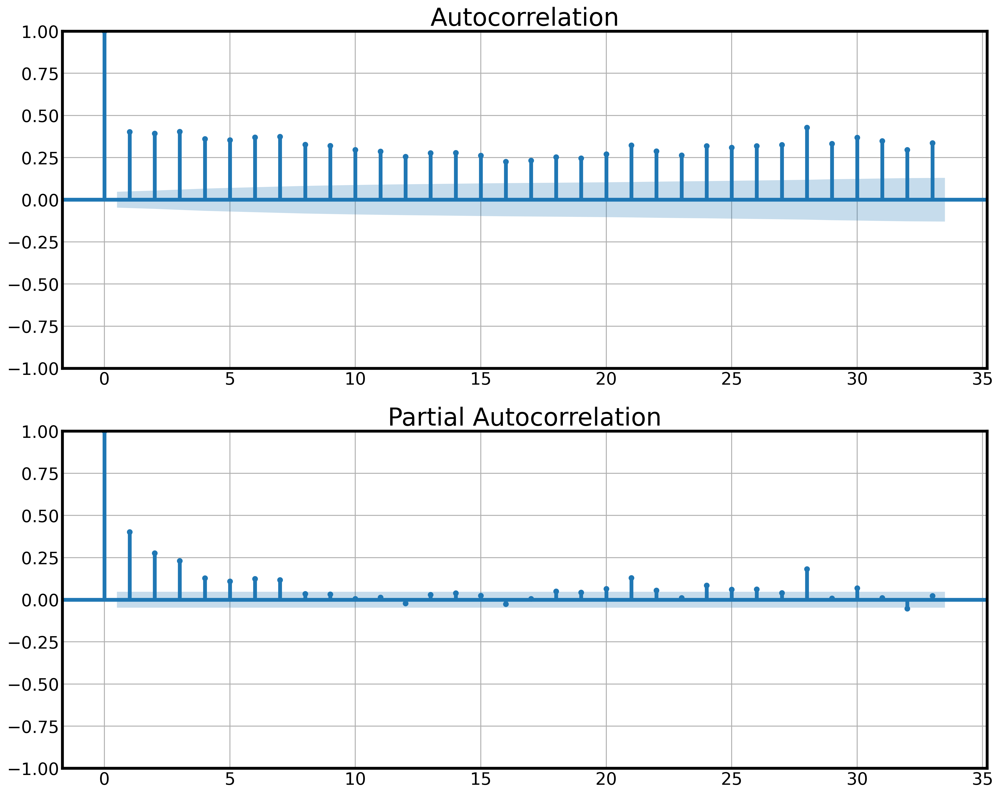

In [ ]:
fig,ax =plt.subplots(2,1,figsize= (15,12))
tsaplots.plot_acf(data_train[2]['cnt'],ax=ax[0]);
tsaplots.plot_pacf(data_train[2]['cnt'],ax=ax[1]);

Попробуем подобрать какие-то усреднённые параметры для всех рядов

In [ ]:
fig,ax = plt.subplots(5*2,3,figsize=(30,30))

for i, art in enumerate(sales.item_id.unique()):
        tsaplots.plot_acf(data_train[i]['cnt'],ax = ax[i//3*2][i%3])
        tsaplots.plot_pacf(data_train[i]['cnt'],ax = ax[i//3*2+1][i%3])

Ой-ой. Может она и не даст нам хорошего результата на чистых данных. Но попробуем

Опять же, для пробы сперва на одном ряду нужно посмотреть

In [ ]:
%%time
forecaster_arima = ARIMA(
    order=(7, 0, 5), suppress_warnings=True
)
forecaster.fit(data_train[2]['cnt'])
y_pred = forecaster.predict(data_test[2].index)

CPU times: user 15min 2s, sys: 4.6 s, total: 15min 6s
Wall time: 9min 14s


In [ ]:
metrics_report(data_test[2]['cnt'], y_pred)

,mean,median
maes,3.583785,3.293997
mses,20.407131,10.852683
mapes,inf,49.566297
r2,-0.020325,-0.020325


<Axes: xlabel='date', ylabel='cnt'>

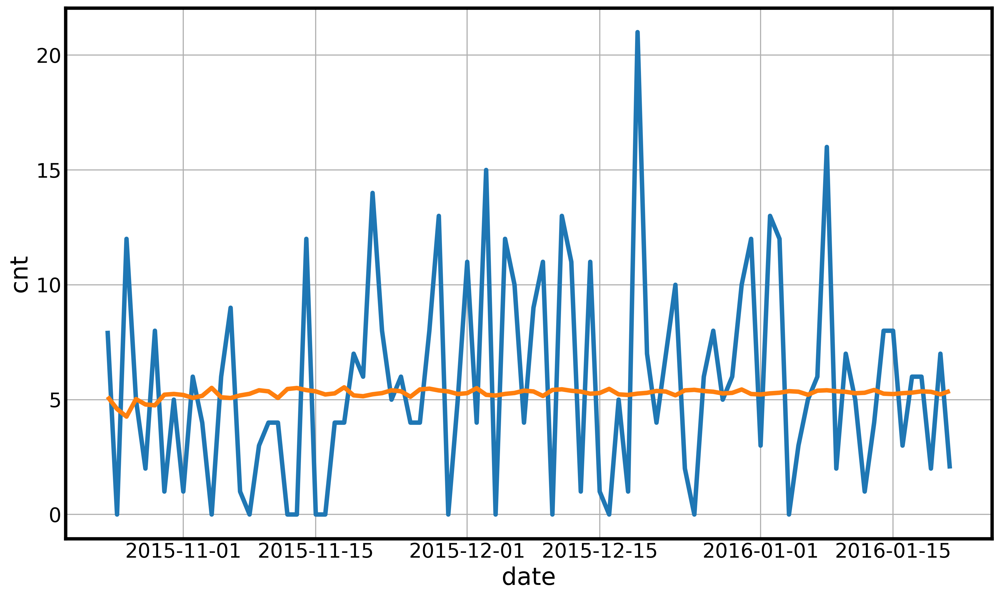

In [ ]:
sns.lineplot(x=data_test[2]['cnt'].index,y=data_test[2]['cnt'].values)
sns.lineplot(x=data_test[2].index,y=y_pred)

Как будто не очень, по попробуем всё же поучить

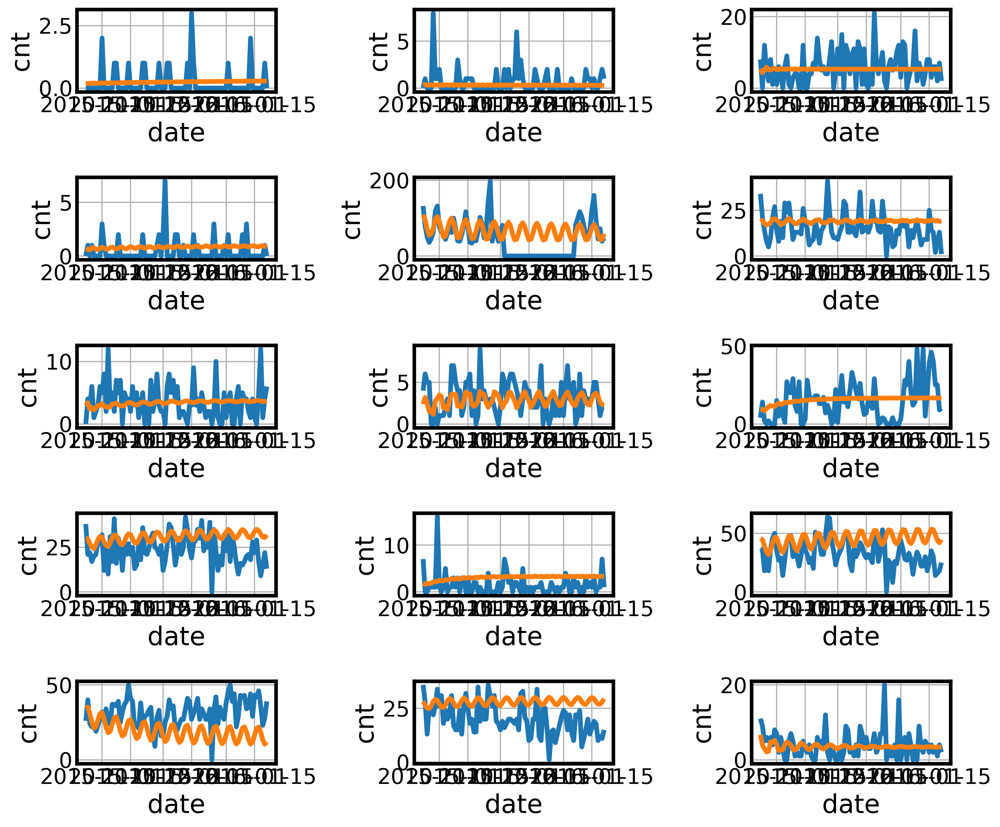

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

mean_arima_res7, mean_arima_res30, mean_arima_res90 = [],[],[]
median_arima_res7, median_arima_res30, median_arima_res90 = [],[],[]

for i, art in enumerate(sales.item_id.unique()):
    forecaster= ARIMA(
    order=(7, 0, 5), suppress_warnings=True
    )
    forecaster.fit(data_train[i]['cnt'])
    mean_arima_res90.append(mean_metrics_report(data_test[i]['cnt'], forecaster.predict(data_test[i].index)))
    mean_arima_res30.append(mean_metrics_report(data_test[i]['cnt'].iloc[:30], forecaster.predict(data_test[i].iloc[:30].index)))
    mean_arima_res7.append(mean_metrics_report(data_test[i]['cnt'].iloc[:7], forecaster.predict(data_test[i].iloc[:7].index)))

    median_arima_res90.append(median_metrics_report(data_test[i]['cnt'], forecaster.predict(data_test[i].index)))
    median_arima_res30.append(median_metrics_report(data_test[i]['cnt'].iloc[:30], forecaster.predict(data_test[i].iloc[:30].index)))
    median_arima_res7.append(median_metrics_report(data_test[i]['cnt'].iloc[:7], forecaster.predict(data_test[i].iloc[:7].index)))

    sns.lineplot(x=data_test[i]['cnt'].index,y=data_test[i]['cnt'].values,ax = ax[i//3][i%3])
    sns.lineplot(x=data_test[i].index,y=forecaster.predict(data_test[i].index),ax = ax[i//3][i%3])

А в целом не так уж и плохо

In [ ]:
arima_result = final_result(mean_arima_res7, mean_arima_res30,
                            mean_arima_res90,median_arima_res7,
                            median_arima_res30, median_arima_res90)

In [ ]:
arima_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,4.676459,4.510555,4.909212,4.246595,7.623818,6.531879
mses,49.720091,43.663639,55.394842,29.152462,221.287544,96.145082
r2,-0.204882,-0.204882,-0.096886,-0.096886,-0.412844,-0.412844


## Экспоненцивльное сглаживание

Стоит попробовать ещё несложные модельки. Глянем, что даст экспоненциальное сглаживани

In [ ]:
data = []
data_train = []
data_test = []
for i, art in enumerate(sales.item_id.unique()):
    data.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id'))
    data_train.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id').iloc[:-90])
    data_test.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id').iloc[-90:])

In [ ]:
es1 = ExponentialSmoothing(data_train[1]['cnt'],initialization_method='heuristic')
es1 = es1.fit()

In [ ]:
metrics_report(data_test[2]['cnt'], es1.predict(start=1730,end= 1819))

,mean,median
maes,5.464395,4.637430
mses,48.726492,21.505759
mapes,inf,94.820432
r2,-1.436249,-1.436249


<Axes: xlabel='date_id', ylabel='None'>

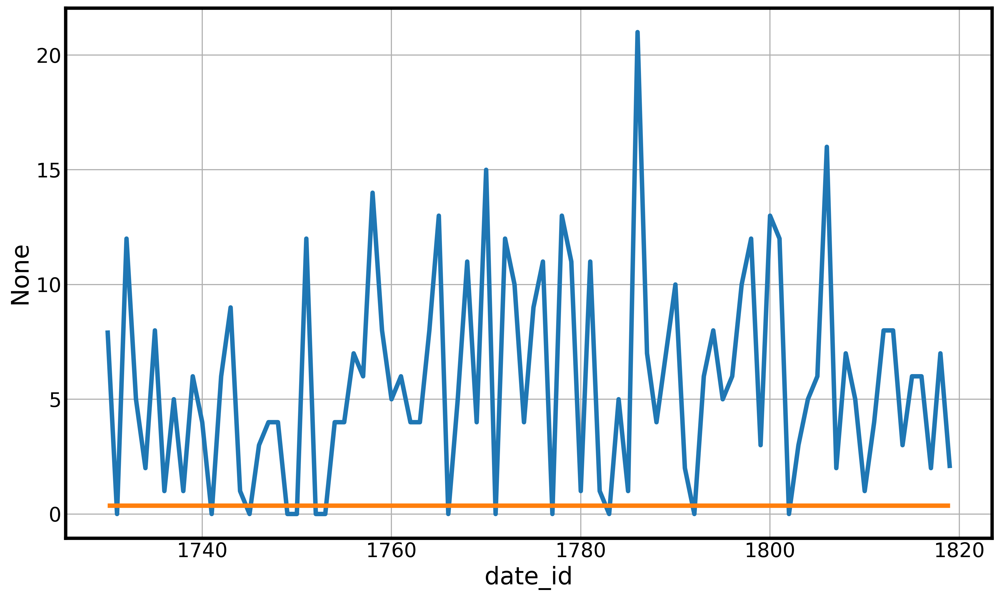

In [ ]:
sns.lineplot(x=data_test[2]['cnt'].index,y=data_test[2]['cnt'].values)
sns.lineplot(x=data_test[2].index,y=es1.predict(start=1730,end= 1819))

Значения слишком небольшие по модулю, наверное поэтому сглаживается слишком сильно. Глянем на общую картину

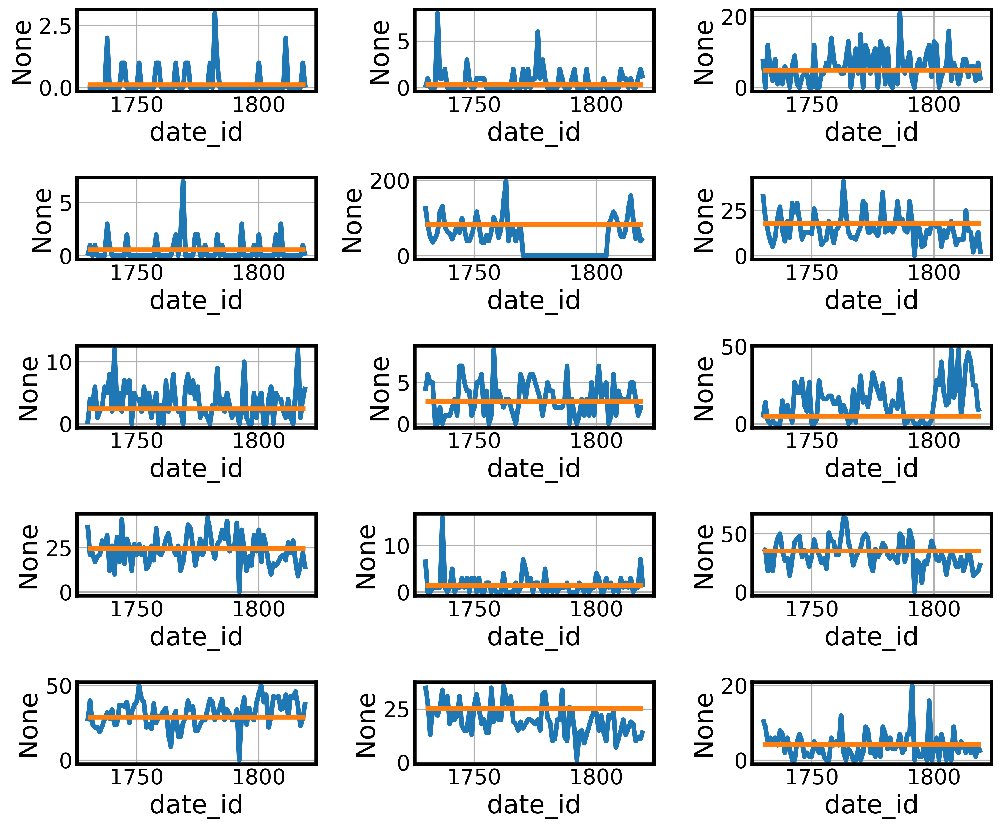

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

mean_es1_res7, mean_es1_res30, mean_es1_res90 = [],[],[]
median_es1_res7, median_es1_res30, median_es1_res90 = [],[],[]

for i, art in enumerate(sales.item_id.unique()):
    es1 = ExponentialSmoothing(data_train[i]['cnt'],initialization_method='heuristic')
    es1 = es1.fit()
    mean_es1_res90.append(mean_metrics_report(data_test[i]['cnt'], es1.predict(start=1730 ,end= 1819)))
    mean_es1_res30.append(mean_metrics_report(data_test[i]['cnt'].iloc[:30], es1.predict(start=1730,end= 1759)))
    mean_es1_res7.append(mean_metrics_report(data_test[i]['cnt'].iloc[:7], es1.predict(start=1730,end= 1736)))

    median_es1_res90.append(median_metrics_report(data_test[i]['cnt'], es1.predict(start=1730,end= 1819)))
    median_es1_res30.append(median_metrics_report(data_test[i]['cnt'].iloc[:30], es1.predict(start=1730,end= 1759)))
    median_es1_res7.append(median_metrics_report(data_test[i]['cnt'].iloc[:7], es1.predict(start=1730,end= 1736)))

    sns.lineplot(x=data_test[i]['cnt'].index,y=data_test[i]['cnt'].values,ax = ax[i//3][i%3])
    sns.lineplot(x=data_test[i].index,y=es1.predict(start=1730,end= 1819),ax = ax[i//3][i%3])

Да, кажется эта можелька нам не подойдёт

In [ ]:
es1_result = final_result(mean_es1_res7, mean_es1_res30, mean_es1_res90,median_es1_res7, median_es1_res30, median_es1_res90)

In [ ]:
es1_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.523034,4.904214,5.566503,5.147878,7.486653,6.334602
mses,111.264916,91.075466,99.166818,64.900421,279.965154,152.369630
r2,-0.157390,-0.157390,-0.101082,-0.101082,-0.157332,-0.157332


### AutoETS

Зжесь ещё можно попробовать AutoETS, может оно даст результаты лучше

In [ ]:
data = []
data_train = []
data_test = []
for i, art in enumerate(sales.item_id.unique()):
    data.append(day_data[day_data['item_id']==art][['date','cnt']].set_index('date'))
    data_train.append(day_data[day_data['item_id']==art][['date','cnt']].set_index('date').iloc[:-90])
    data_test.append(day_data[day_data['item_id']==art][['date','cnt']].set_index('date').iloc[-90:])

In [ ]:
forecaster = AutoETS(auto=True, sp=7, n_jobs=-1)
forecaster.fit(data_train[2])
y_pred = forecaster.predict(data_test[2].index)

metrics_report(data_test[2], y_pred)

,mean,median
maes,3.441881,3.313185
mses,19.147593,11.005750
mapes,inf,45.835812
r2,0.042650,0.042650


<Axes: xlabel='date'>

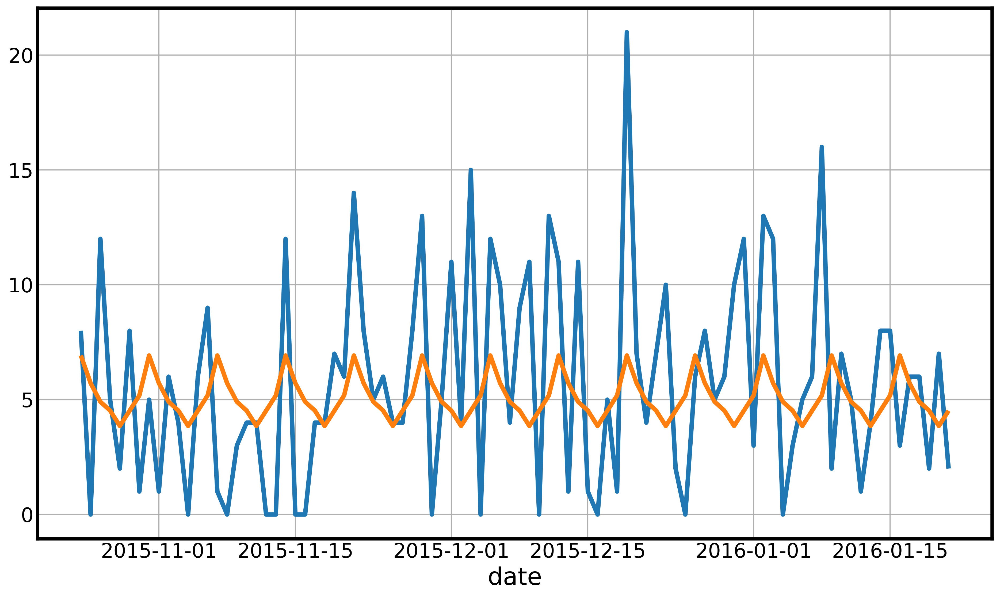

In [ ]:
sns.lineplot(x=data_test[2].index,y=data_test[2]['cnt'].values)
sns.lineplot(x=data_test[2].index,y=y_pred['cnt'].values)

In [ ]:
forecaster = AutoETS(auto=True, sp=7, n_jobs=-1)
forecaster.fit(data_train[2])
y_pred = forecaster.predict(data_test[2].index)

metrics_report(data_test[2], y_pred)

,mean,median
maes,3.441881,3.313185
mses,19.147593,11.005750
mapes,inf,45.835812
r2,0.042650,0.042650


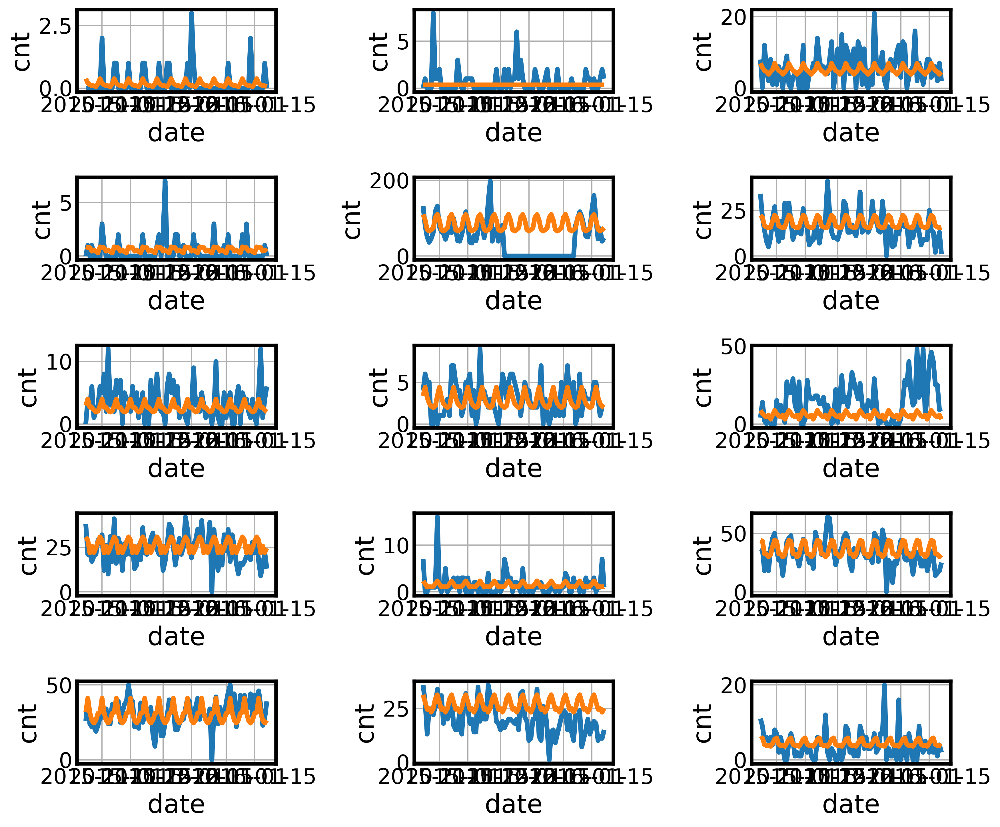

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

mean_ets_res7, mean_ets_res30, mean_ets_res90 = [],[],[]
median_ets_res7, median_ets_res30, median_ets_res90 = [],[],[]
model_ets =[]

for i, art in enumerate(sales.item_id.unique()):
    ets = AutoETS(auto=True, sp=7, n_jobs=-1)
    ets = ets.fit(data_train[i])
    model_ets.append(ets)
    mean_ets_res90.append(mean_metrics_report(data_test[i]['cnt'], ets.predict(data_test[i].index)))
    mean_ets_res30.append(mean_metrics_report(data_test[i]['cnt'].iloc[:30], ets.predict(data_test[i].iloc[:30].index)))
    mean_ets_res7.append(mean_metrics_report(data_test[i]['cnt'].iloc[:7], ets.predict(data_test[i].iloc[:7].index)))

    median_ets_res90.append(median_metrics_report(data_test[i]['cnt'], ets.predict(data_test[i].index)))
    median_ets_res30.append(median_metrics_report(data_test[i]['cnt'].iloc[:30], ets.predict(data_test[i].iloc[:30].index)))
    median_ets_res7.append(median_metrics_report(data_test[i]['cnt'].iloc[:7], ets.predict(data_test[i].iloc[:7].index)))

    sns.lineplot(x=data_test[i]['cnt'].index,y=data_test[i]['cnt'].values,ax = ax[i//3][i%3])
    sns.lineplot(x=data_test[i].index,y=ets.predict(data_test[2].index)['cnt'],ax = ax[i//3][i%3])

In [ ]:
import joblib

In [ ]:
joblib.dump(model_ets,'model_ets.joblib')

['model_ets.joblib']

In [ ]:
model_ets

[AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7)]

In [ ]:
joblib.load('model_ets.joblib')

[AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7),
 AutoETS(auto=True, n_jobs=-1, sp=7)]

In [ ]:
ets_result = final_result(mean_ets_res7, mean_ets_res30, mean_ets_res90,median_ets_res7, median_ets_res30, median_ets_res90)

In [ ]:
ets_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,4.168081,3.968856,4.695078,4.415057,7.036682,5.479157
mses,46.699550,37.742152,61.433119,40.434152,270.544000,84.598934
r2,0.109908,0.109908,0.082960,0.082960,-0.102014,-0.102014


Уже явно лучше. Глянем и для других периодов обучение тоже

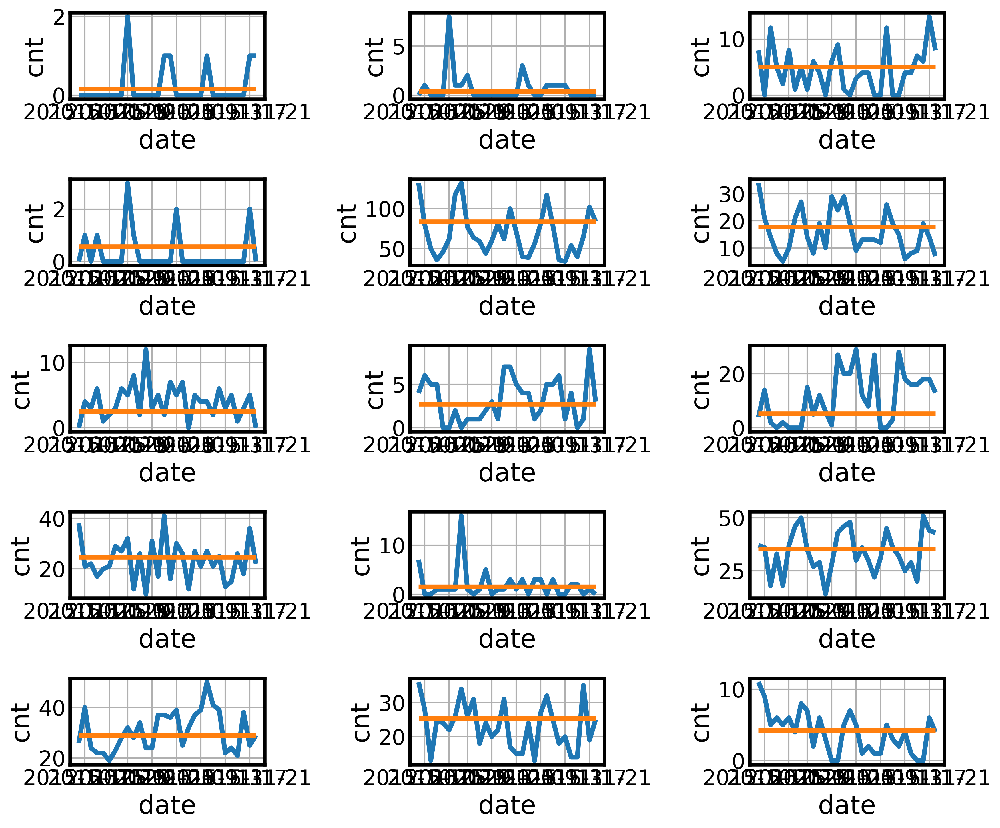

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

mean_ets1_res7, mean_ets1_res30, mean_ets1_res90 = [],[],[]
median_ets1_res7, median_ets1_res30, median_ets1_res90 = [],[],[]

for i, art in enumerate(sales.item_id.unique()):
    ets = AutoETS(auto=True, sp=30, n_jobs=-1)
    ets = ets.fit(data_train[i])
    mean_ets1_res90.append(mean_metrics_report(data_test[i]['cnt'], ets.predict(data_test[i].index)))
    mean_ets1_res30.append(mean_metrics_report(data_test[i]['cnt'].iloc[:30], ets.predict(data_test[i].iloc[:30].index)))
    mean_ets1_res7.append(mean_metrics_report(data_test[i]['cnt'].iloc[:7], ets.predict(data_test[i].iloc[:7].index)))

    median_ets1_res90.append(median_metrics_report(data_test[i]['cnt'], ets.predict(data_test[i].index)))
    median_ets1_res30.append(median_metrics_report(data_test[i]['cnt'].iloc[:30], ets.predict(data_test[i].iloc[:30].index)))
    median_ets1_res7.append(median_metrics_report(data_test[i]['cnt'].iloc[:7], ets.predict(data_test[i].iloc[:7].index)))

    sns.lineplot(x=data_test[i]['cnt'].iloc[:30].index,y=data_test[i]['cnt'].iloc[:30].values,ax = ax[i//3][i%3])
    sns.lineplot(x=data_test[i].iloc[:30].index,y=ets.predict(data_test[2].iloc[:30].index)['cnt'],ax = ax[i//3][i%3])

In [ ]:
ets1_result = final_result(mean_ets1_res7, mean_ets1_res30, mean_ets1_res90,median_ets1_res7, median_ets1_res30, median_ets1_res90)

In [ ]:
ets1_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.531406,4.917147,5.569341,5.156207,7.489495,6.341611
mses,111.284087,91.141986,99.133532,64.909196,279.923183,152.360015
r2,-0.157504,-0.157504,-0.098125,-0.098125,-0.155406,-0.155406


Период побольше теряет колебания, наверное 90 дней даже пробовать не буду

## TBATS

Попробуем ещё большую модель. Сперва глянем, как она отработает на одном ряду со всеми доступными утяжелениями

In [ ]:
forecaster1 = TBATS(

    use_box_cox=True,

    use_trend=True,

    use_damped_trend=True,

    sp=[7.,30.5,365.25],
    use_arma_errors=False,)

In [ ]:
%%time
fitted_model = forecaster1.fit(data_train[2])

CPU times: user 2min 31s, sys: 704 ms, total: 2min 32s
Wall time: 2min 32s


In [ ]:
data_test[2]['x']= data_test[2].index

In [ ]:
y_pred = forecaster1.predict(X=data_test[2]['x'],fh=range(90))

metrics_report(data_test[2]['cnt'], y_pred)

,mean,median
maes,4.385952,3.628314
mses,30.966980,13.166295
mapes,inf,67.889917
r2,-0.548301,-0.548301


<Axes: xlabel='date', ylabel='cnt'>

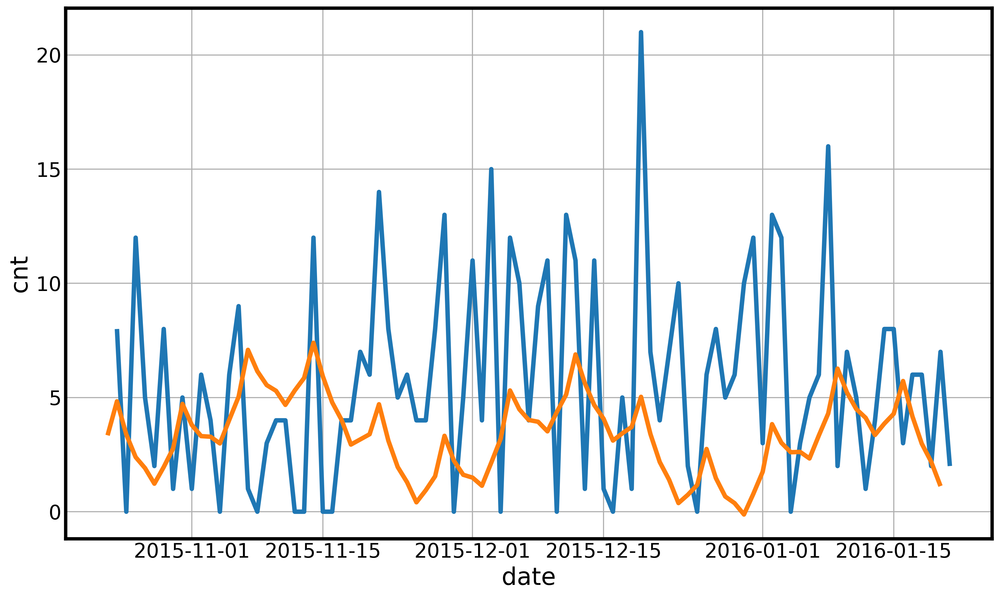

In [ ]:
sns.lineplot(data = data_test[2],
                     x=data_test[2].index, y='cnt')
sns.lineplot(x=y_pred.index, y=y_pred['cnt'].values)

И глянем некоторые другие настройки

In [ ]:
forecaster2 = TBATS(
    use_box_cox=False,
    use_trend=True,
    use_damped_trend=True,
    sp=[7.,30.5,90.25],
    use_arma_errors=False,)

In [ ]:
%%time
fitted_model2 = forecaster2.fit(data_train[2])

CPU times: user 3min 51s, sys: 1.07 s, total: 3min 52s
Wall time: 3min 53s


In [ ]:
y_pred = forecaster2.predict(X=data_test[2]['x'],fh=range(90))

metrics_report(data_test[2]['cnt'], y_pred)

,mean,median
maes,3.772286,3.041985
mses,22.341021,9.253794
mapes,inf,51.109505
r2,-0.117017,-0.117017


<Axes: xlabel='date', ylabel='cnt'>

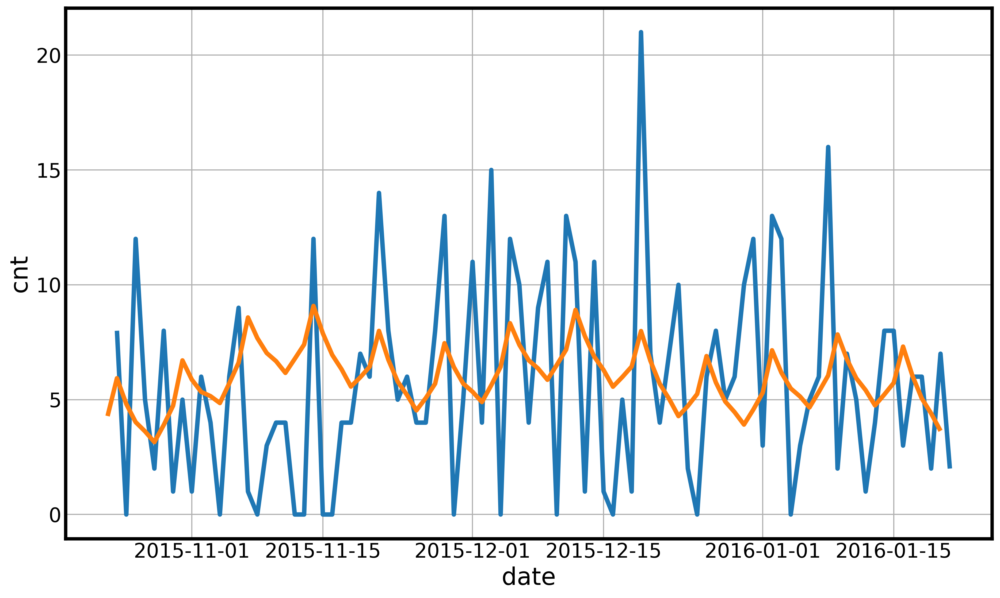

In [ ]:
sns.lineplot(data = data_test[2],
                     x=data_test[2].index, y='cnt')
sns.lineplot(x=y_pred.index, y=y_pred['cnt'].values)

In [ ]:
forecaster3 = TBATS(
    use_box_cox=False,
    use_trend=False,
    use_damped_trend=True,
    sp=[7.,30.5,90.25],
    use_arma_errors=False,)

In [ ]:
%%time
fitted_model3 = forecaster3.fit(data_train[2])

CPU times: user 2min 55s, sys: 772 ms, total: 2min 56s
Wall time: 2min 56s


In [ ]:
y_pred = forecaster3.predict(X=data_test[2]['x'],fh=range(90))

metrics_report(data_test[2]['cnt'], y_pred)

,mean,median
maes,3.750824,3.255905
mses,22.074466,10.633048
mapes,inf,49.805730
r2,-0.103689,-0.103689


<Axes: xlabel='date', ylabel='cnt'>

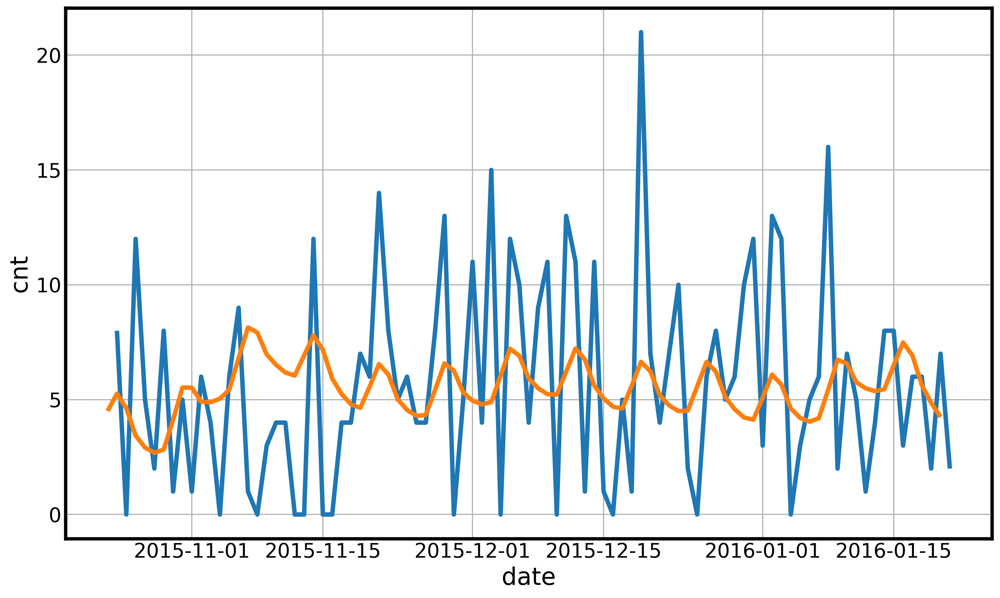

In [ ]:
sns.lineplot(data = data_test[2],
                     x=data_test[2].index, y='cnt')
sns.lineplot(x=y_pred.index, y=y_pred['cnt'].values)

In [ ]:
forecaster4 = TBATS(
    use_box_cox=False,
    use_trend=False,
    use_damped_trend=True,
    sp=[7.,30.5,90.25],
    use_arma_errors=True,)

In [ ]:
%%time
fitted_model4 = forecaster4.fit(data_train[2])

CPU times: user 4min 4s, sys: 1.22 s, total: 4min 5s
Wall time: 3min 53s


In [ ]:
y_pred = forecaster4.predict(X=data_test[2]['x'],fh=range(90))

metrics_report(data_test[2]['cnt'], y_pred)

,mean,median
maes,3.750824,3.255905
mses,22.074466,10.633048
mapes,inf,49.805730
r2,-0.103689,-0.103689


<Axes: xlabel='date', ylabel='cnt'>

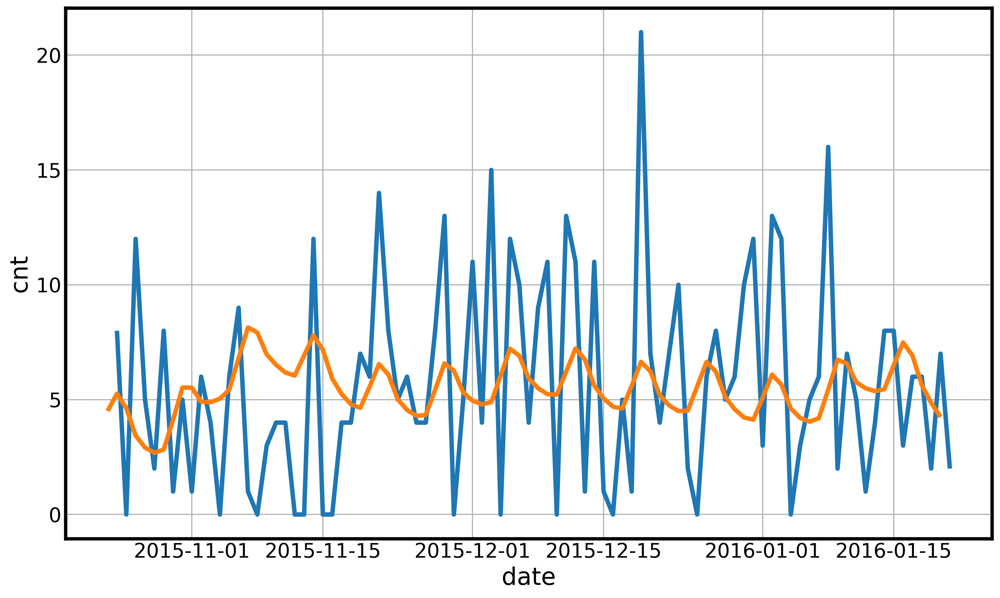

In [ ]:
sns.lineplot(data = data_test[2],
                     x=data_test[2].index, y='cnt')
sns.lineplot(x=y_pred.index, y=y_pred['cnt'].values)

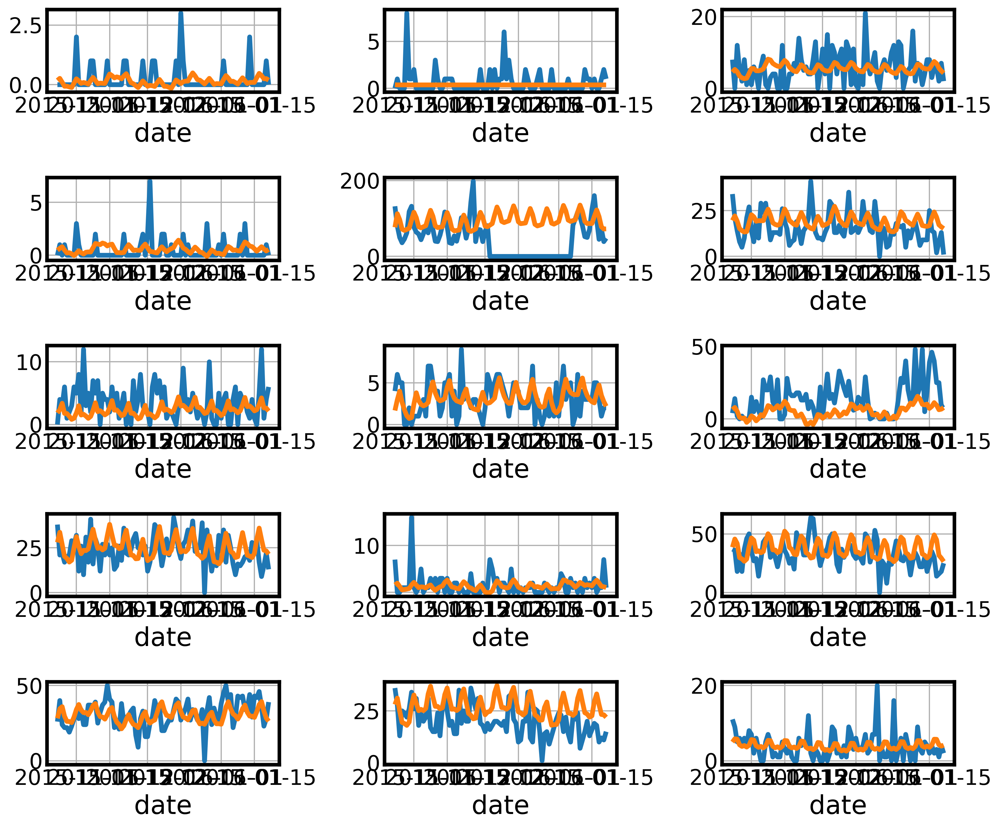

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

mean_tbats_res7, mean_tbats_res30, mean_tbats_res90 = [],[],[]
median_tbats_res7, median_tbats_res30, median_tbats_res90 = [],[],[]

for i, art in enumerate(sales.item_id.unique()):
    tbats = TBATS(
                use_box_cox=False,
                use_trend=False,
                use_damped_trend=True,
                sp=[7.,30.5,90.25],
                use_arma_errors=False)
    tbats = tbats.fit(data_train[i])
    data_test[i]['x']= data_test[i].index

    mean_tbats_res90.append(mean_metrics_report(data_test[i]['cnt'], tbats.predict(X=data_test[i]['x'],fh=range(90))))
    mean_tbats_res30.append(mean_metrics_report(data_test[i]['cnt'].iloc[:30], tbats.predict(X=data_test[i]['x'].iloc[:30],fh=range(30))))
    mean_tbats_res7.append(mean_metrics_report(data_test[i]['cnt'].iloc[:7], tbats.predict(X=data_test[i]['x'].iloc[:7],fh=range(7))))

    median_tbats_res90.append(median_metrics_report(data_test[i]['cnt'], tbats.predict(X=data_test[i]['x'],fh=range(90))))
    median_tbats_res30.append(median_metrics_report(data_test[i]['cnt'].iloc[:30], tbats.predict(X=data_test[i]['x'].iloc[:30],fh=range(30))))
    median_tbats_res7.append(median_metrics_report(data_test[i]['cnt'].iloc[:7], tbats.predict(X=data_test[i]['x'].iloc[:7],fh=range(7))))

    sns.lineplot(x=data_test[i]['cnt'].index,y=data_test[i]['cnt'].values,ax = ax[i//3][i%3])
    sns.lineplot(x=data_test[i]['cnt'].index,y=tbats.predict(X=data_test[i]['x'],fh=range(90))['cnt'].values,ax = ax[i//3][i%3])

In [ ]:
tbats_result = final_result(mean_tbats_res7, mean_tbats_res30, mean_tbats_res90,median_tbats_res7, median_tbats_res30, median_tbats_res90)

In [ ]:
tbats_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.796983,5.436769,6.012980,5.866195,8.250770,6.812624
mses,125.850151,103.863471,111.359267,92.608584,384.111033,160.151857
r2,-0.101032,-0.101032,-0.233175,-0.233175,-0.303367,-0.303367


Это уже лучше, но учится очень долго. Стоит думать, а стоит ли оно того или нет

## Prophet

Вообще, выше я предполагала, что есть зависимость от праздников. Можно проверить это, использовав профет

In [ ]:
data = []
data_train = []
data_test = []
for i, art in enumerate(sales.item_id.unique()):
    data.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id'))
    data_train.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id').iloc[:-90])
    data_test.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id').iloc[-90:])

In [ ]:
calendar_cp = calendar.copy().set_index('date')
calendar_cp.index = pd.to_datetime(calendar_cp.index, format='%Y-%m-%d')
calendar_cp.sort_index(inplace=True)
calendar_cashback_col = calendar_cp['CASHBACK_STORE_2']
calendar_cp.drop(['CASHBACK_STORE_1', 'CASHBACK_STORE_2', 'CASHBACK_STORE_3', 'wday', 'month', 'year', 'weekday'],
                      axis=1,
                      inplace=True)
fill_values = {'event_name_1': 'noevent',
                       'event_name_2': 'noevent',
                       'event_type_1': 'notype',
                       'event_type_2': 'notype'
        }
calendar_cp.fillna(value = fill_values, inplace=True)
calendar_cp['CASHBACK_STORE_2'] = calendar_cashback_col

In [ ]:
calendar_cp

,wm_yr_wk,event_name_1,event_type_1,event_name_2,event_type_2,date_id,CASHBACK_STORE_2
date,,,,,,,
2011-01-29,11101,noevent,notype,noevent,notype,1,0
2011-01-30,11101,noevent,notype,noevent,notype,2,0
2011-01-31,11101,noevent,notype,noevent,notype,3,0
2011-02-01,11101,noevent,notype,noevent,notype,4,1
2011-02-02,11101,noevent,notype,noevent,notype,5,1
...,...,...,...,...,...,...,...
2016-01-17,11551,noevent,notype,noevent,notype,1815,0
2016-01-18,11551,MartinLutherKingDay,National,noevent,notype,1816,0
2016-01-19,11551,noevent,notype,noevent,notype,1817,0


In [ ]:
holidays = calendar_cp.drop(['event_type_1','event_type_2','wm_yr_wk','date_id'],axis=1)

In [ ]:
holidays

,event_name_1,event_name_2,CASHBACK_STORE_2
date,,,
2011-01-29,noevent,noevent,0
2011-01-30,noevent,noevent,0
2011-01-31,noevent,noevent,0
2011-02-01,noevent,noevent,1
2011-02-02,noevent,noevent,1
...,...,...,...
2016-01-17,noevent,noevent,0
2016-01-18,MartinLutherKingDay,noevent,0
2016-01-19,noevent,noevent,0


In [ ]:
conditions = [
    (holidays.event_name_1 != 'noevent') & (holidays.event_name_2 != 'noevent'),
    (holidays.event_name_1 != 'noevent') ^ (holidays.event_name_2 != 'noevent'),
    (holidays.event_name_1 == 'noevent') & (holidays.event_name_2 == 'noevent')
]

lower_window = [-5, -3, None]
upper_window = [5, 3, None]

holidays['lower_window'] = np.select(conditions, lower_window)
holidays['upper_window'] = np.select(conditions, upper_window)

holidays = holidays.dropna()

In [ ]:
holidays[holidays.event_name_1 == 'noevent']['event_name_1'] = holidays[holidays.event_name_1 == 'noevent']['event_name_2']

In [ ]:
holidays.event_name_1.value_counts()

,count
event_name_1,
SuperBowl,5
ValentinesDay,5
MartinLutherKingDay,5
OrthodoxChristmas,5
NewYear,5
Chanukah End,5
Christmas,5
Thanksgiving,5
VeteransDay,5


In [ ]:
holidays['holiday'] = holidays['event_name_1']
holidays = holidays.drop(['event_name_1','event_name_2'],axis=1)

In [ ]:
holidays

,CASHBACK_STORE_2,lower_window,upper_window,holiday
date,,,,
2011-02-06,1,-3,3,SuperBowl
2011-02-14,0,-3,3,ValentinesDay
2011-02-21,0,-3,3,PresidentsDay
2011-03-09,1,-3,3,LentStart
2011-03-16,0,-3,3,LentWeek2
...,...,...,...,...
2015-12-14,0,-3,3,Chanukah End
2015-12-25,0,-3,3,Christmas
2016-01-01,1,-3,3,NewYear


In [ ]:
prophet_holidays = holidays.copy()
prophet_holidays['ds']=prophet_holidays.index
# prophet_holidays.drop

In [ ]:
forecaster = Prophet(holidays=prophet_holidays)

In [ ]:
data_train[2]['ds']=data_train[2]['date']
data_train[2]['y']=data_train[2]['cnt']
data_train[2] = data_train[2].set_index('date')
data_test[2] = data_test[2].set_index('date')

In [ ]:
data_train[2]

,cnt,ds,y
date,,,
2011-01-29,0,2011-01-29,0
2011-01-30,0,2011-01-30,0
2011-01-31,0,2011-01-31,0
2011-02-01,0,2011-02-01,0
2011-02-02,0,2011-02-02,0
...,...,...,...
2015-10-19,0,2015-10-19,0
2015-10-20,6,2015-10-20,6
2015-10-21,6,2015-10-21,6


In [ ]:
forecaster.fit(data_train[2])

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuzgcgswq/ap8y8hzr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuzgcgswq/y7c2fcx1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=455', 'data', 'file=/tmp/tmpuzgcgswq/ap8y8hzr.json', 'init=/tmp/tmpuzgcgswq/y7c2fcx1.json', 'output', 'file=/tmp/tmpuzgcgswq/prophet_modelzcw56dw4/prophet_model-20241003084430.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:44:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:44:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
future = forecaster.make_future_dataframe(periods=90)
forecast = forecaster.predict(future)

In [ ]:
metrics_report(data_test[2]['cnt'], forecast['yhat'].iloc[-90:])

,mean,median
maes,3.770751,3.129868
mses,22.177889,9.803929
mapes,inf,49.816425
r2,-0.108860,-0.108860


In [ ]:
data_test[2]

,cnt
date,
2015-10-24,8
2015-10-25,0
2015-10-26,12
2015-10-27,5
2015-10-28,2
...,...
2016-01-17,6
2016-01-18,6
2016-01-19,2


<Axes: xlabel='date', ylabel='cnt'>

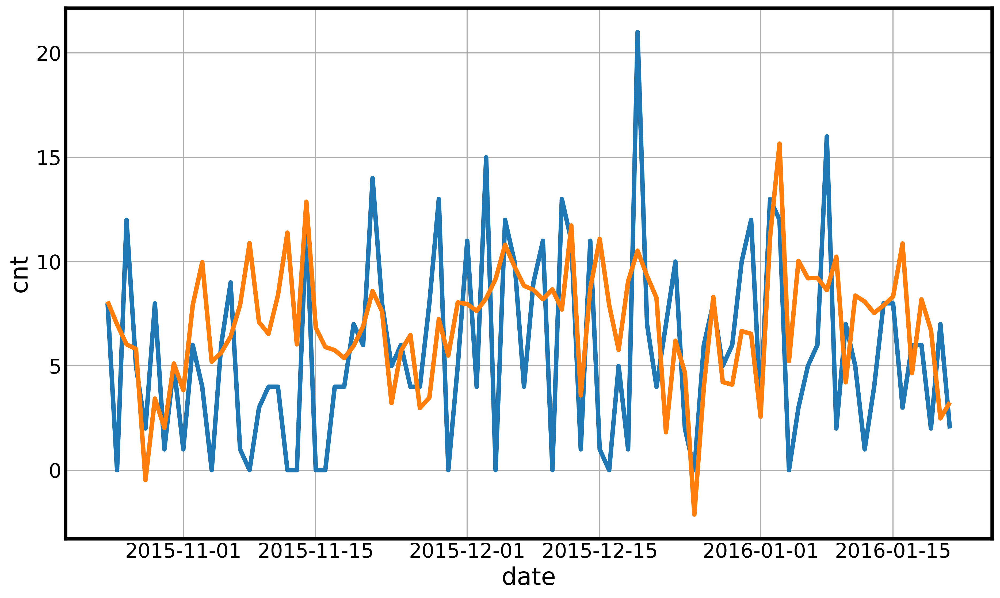

In [ ]:
sns.lineplot(data = data_test[2],
                     x=data_test[2].index, y='cnt')
sns.lineplot(data = forecast[['yhat','ds']].iloc[-90:],
    x='ds', y='yhat')

In [ ]:
data = []
data_train = []
data_test = []
for i, art in enumerate(sales.item_id.unique()):
    data.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id'))
    data_train.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id').iloc[:-90])
    data_test.append(day_data[day_data['item_id']==art][['date','date_id','cnt']].set_index('date_id').iloc[-90:])

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuzgcgswq/ouf1l0as.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuzgcgswq/mw_lvfaq.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=62412', 'data', 'file=/tmp/tmpuzgcgswq/ouf1l0as.json', 'init=/tmp/tmpuzgcgswq/mw_lvfaq.json', 'output', 'file=/tmp/tmpuzgcgswq/prophet_modeldre22n16/prophet_model-20241003084436.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
08:44:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:44:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpuz

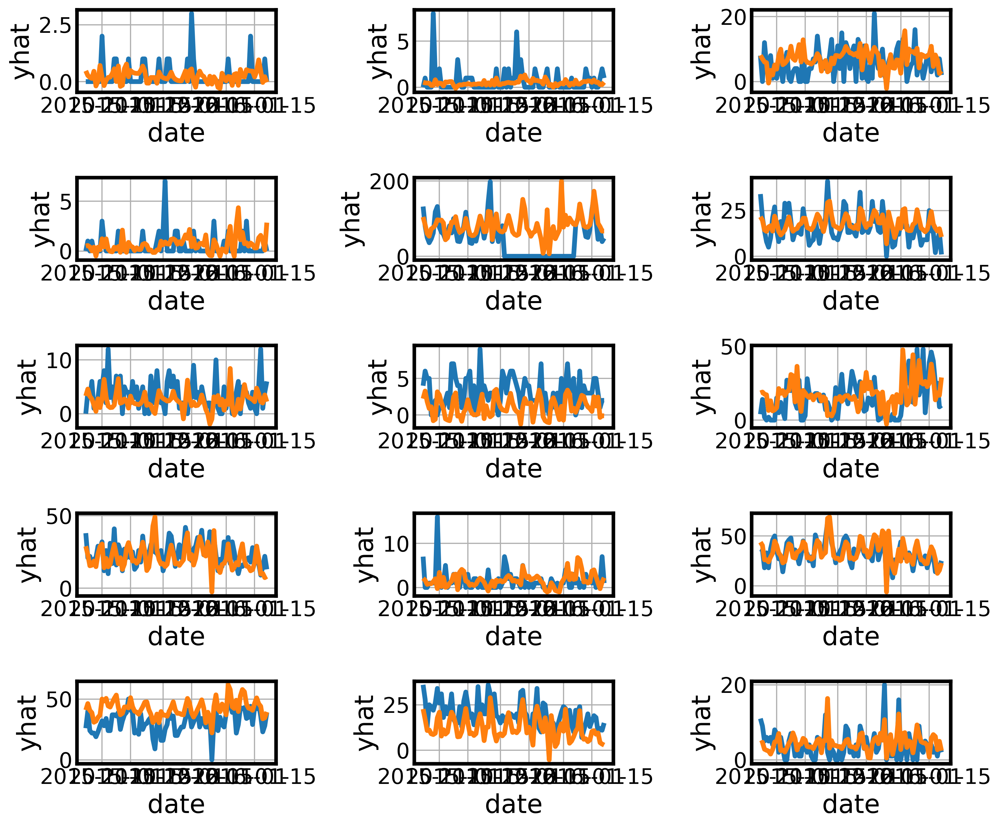

In [ ]:
fig,ax = plt.subplots(5,3,figsize=(12,10))

mean_prophet_res7, mean_prophet_res30, mean_prophet_res90 = [],[],[]
median_prophet_res7, median_prophet_res30, median_prophet_res90 = [],[],[]
model = []

for i, art in enumerate(sales.item_id.unique()):
    prophet = Prophet(holidays=prophet_holidays)
    data_train[i]['ds']=data_train[i]['date']
    data_train[i]['y']=data_train[i]['cnt']
    data_train[i] = data_train[i].set_index('date')
    data_test[i] = data_test[i].set_index('date')
    prophet.fit(data_train[i])
    model
    future90 = prophet.make_future_dataframe(periods=90)
    future30 = prophet.make_future_dataframe(periods=30)
    future7 = prophet.make_future_dataframe(periods=7)

    mean_prophet_res90.append(mean_metrics_report(data_test[i]['cnt'], prophet.predict(future90)['yhat'].iloc[-90:]))
    mean_prophet_res30.append(mean_metrics_report(data_test[i]['cnt'].iloc[:30], prophet.predict(future30)['yhat'].iloc[-90:-60]))
    mean_prophet_res7.append(mean_metrics_report(data_test[i]['cnt'].iloc[:7], prophet.predict(future7)['yhat'].iloc[-90:-83]))

    median_prophet_res90.append(median_metrics_report(data_test[i]['cnt'], prophet.predict(future90)['yhat'].iloc[-90:]))
    median_prophet_res30.append(median_metrics_report(data_test[i]['cnt'].iloc[:30], prophet.predict(future30)['yhat'].iloc[-90:-60]))
    median_prophet_res7.append(median_metrics_report(data_test[i]['cnt'].iloc[:7], prophet.predict(future7)['yhat'].iloc[-90:-83]))

    sns.lineplot(x=data_test[i]['cnt'].index,y=data_test[i]['cnt'].values,ax = ax[i//3][i%3])
    sns.lineplot(x=data_test[i]['cnt'].index,y=prophet.predict(future90)['yhat'].iloc[-90:],ax = ax[i//3][i%3])

In [ ]:
profet_result = final_result(mean_prophet_res7, mean_prophet_res30, mean_prophet_res90,median_prophet_res7, median_prophet_res30, median_prophet_res90 )

In [ ]:
profet_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,6.119307,4.699459,7.558079,7.012842,6.981179,5.549598
mses,130.022720,47.887846,211.440792,126.667474,257.149680,75.887352
r2,-0.932693,-0.932693,-0.754043,-0.754043,-0.274781,-0.274781


Визуально очень хорошо,обучилось весьма быстро, но посмотрим, что у нас по метрикам дальше

# Пункт 4: Оценка экспериментов

In [ ]:
result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.180952,4.133333,7.202222,5.900000,8.200000,6.700000
mses,69.638095,32.533333,165.584444,83.100000,280.088889,129.366667
r2,-3.776800,-3.776800,-1.659166,-1.659166,-1.194312,-1.194312


In [ ]:
arima_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,4.676459,4.510555,4.909212,4.246595,7.623818,6.531879
mses,49.720091,43.663639,55.394842,29.152462,221.287544,96.145082
r2,-0.204882,-0.204882,-0.096886,-0.096886,-0.412844,-0.412844


In [ ]:
es1_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.523034,4.904214,5.566503,5.147878,7.486653,6.334602
mses,111.264916,91.075466,99.166818,64.900421,279.965154,152.369630
r2,-0.157390,-0.157390,-0.101082,-0.101082,-0.157332,-0.157332


In [ ]:
ets_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,4.168081,3.968856,4.695078,4.415057,7.036682,5.479157
mses,46.699550,37.742152,61.433119,40.434152,270.544000,84.598934
r2,0.109908,0.109908,0.082960,0.082960,-0.102014,-0.102014


In [ ]:
ets1_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.531406,4.917147,5.569341,5.156207,7.489495,6.341611
mses,111.284087,91.141986,99.133532,64.909196,279.923183,152.360015
r2,-0.157504,-0.157504,-0.098125,-0.098125,-0.155406,-0.155406


In [ ]:
tbats_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,5.796983,5.436769,6.012980,5.866195,8.250770,6.812624
mses,125.850151,103.863471,111.359267,92.608584,384.111033,160.151857
r2,-0.101032,-0.101032,-0.233175,-0.233175,-0.303367,-0.303367


In [ ]:
profet_result

,mean_week,median_week,mean_month,median_month,mean_quarter,median_quarter
maes,6.119307,4.699459,7.558079,7.012842,6.981179,5.549598
mses,130.022720,47.887846,211.440792,126.667474,257.149680,75.887352
r2,-0.932693,-0.932693,-0.754043,-0.754043,-0.274781,-0.274781


Итого: Лучшие результаты на короткосрок у нас у AutoETS, так что для недели и месяца возьмём эту модель, лучшие результаты на квартал у Prophet, поэтому для квартала - обучим его. Мы можем себе это позволить, так как обе модельки обучались довольно быстро в рамках экспериментов